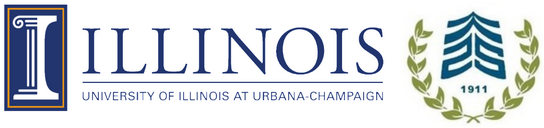

# Matrix Factorization Based Dimensionality Reduction for Mass Spectra - A Comparative Study

An overview of dimensionality reduction algorithms

    Non-Convex	Stochastic methods	
        Weighted Euclidean distances	Sammon mapping[2]
        Neural networks	Autoencoder[3]
        Discrete mapping	SOM[4], GTM[5]
        Alignment of local linear models	LLC[6]
    Convex	
        Full spectral	Euclidean distances	PCA
            Geodesic distances	Isomap[7]
            Diffusion distances	Diffusion maps[8]
            Kernel-based	Kernel-PCA, MDS
        Sparse spectral	Neighborhood graph	Laplacian eigenmaps[9]
            Reconstruction weights	LLE[10]
            Local tangent space	Hessian LLE[11]
            
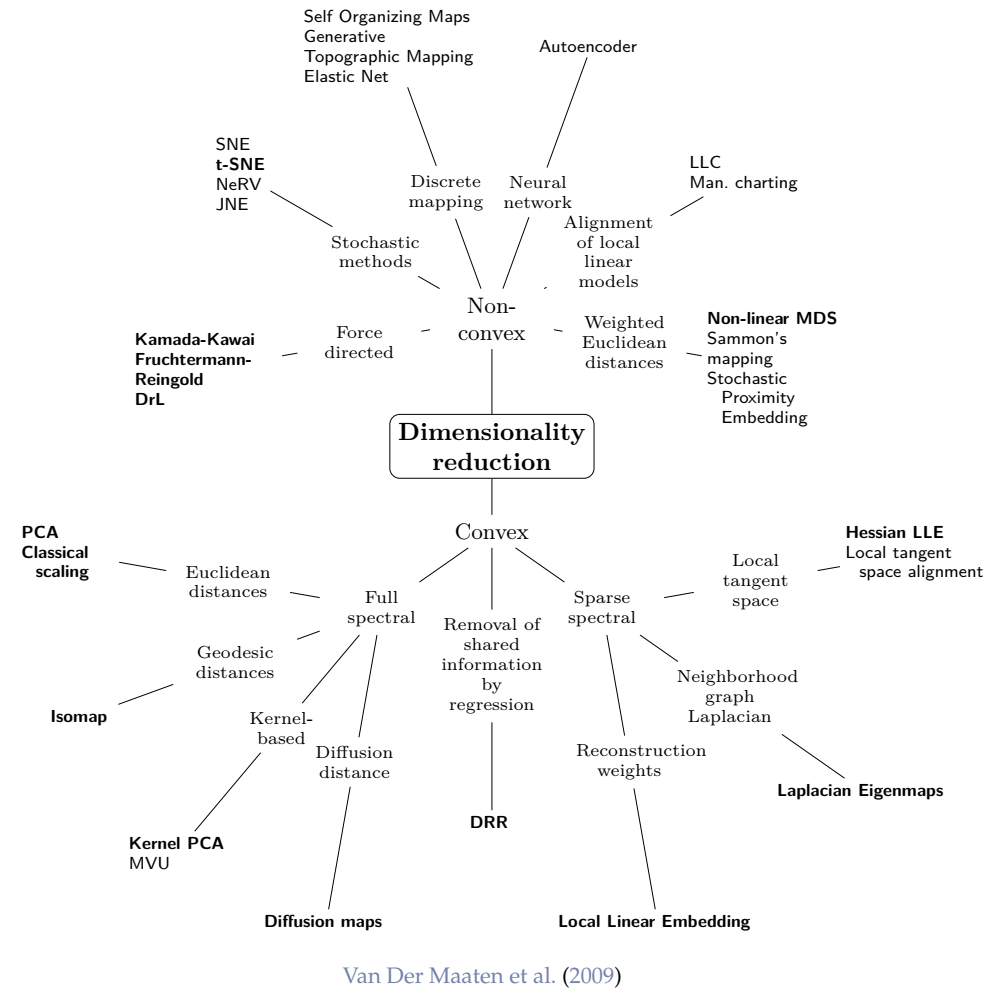

# Reasons for dimensonality reduction: 

1. Reduce computational cost for learning and inference. 
2. Reduce the risk of overfitting. 
3. For data visualization.
4. For data interpretation. Clustering is a special form of dimensionality reduction

# 1. Load Data

["金典纯牛奶","金典有机纯牛奶"]

仪器：4800 plus MALDI-TOF/TOF质谱仪（AB Sciex，美国），配备Dd：YAG激光器（波长355 nm）。实验所采用的模式是正离子线性模式，激光强度7500。每张谱图来源于目标点上400次扫描谱图的叠加，数据处理工作由AB Sciex的软件Data Explorer执行。
样本：牛奶原液稀释100倍，与基质SA（浓度为10 mg/mL）混合，滴加至金属靶板，空气中自然待干，检测。

`pip install qsi` to use data I/O functions.

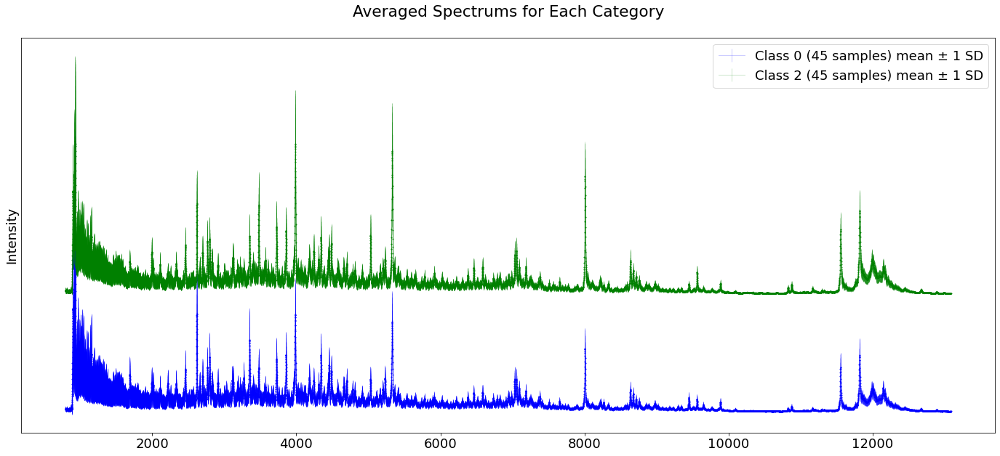

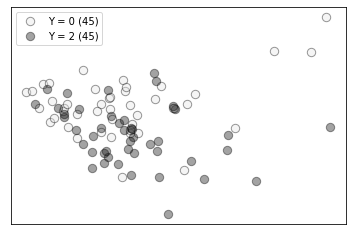

MALDITOFMS_ORGANICMILK_7047_C02.csv

仪器：4800 plus MALDI-TOF/TOF质谱仪（AB Sciex，美国），配备Dd：YAG激光器（波长355 nm）。实验所采用的模式是正离子线性模式，激光强度7500。每张谱图来源于目标点上400次扫描谱图的叠加，数据处理工作由AB Sciex的软件Data Explorer执行。
样本：牛奶原液稀释100倍，与基质SA（浓度为10 mg/mL）混合，滴加至金属靶板，空气中自然待干，检测。

--------------------
If you use this data set, please add the reference: 
[1] Matrix Factorization Based Dimensionality Reduction Algorithms - A Comparative Study on Spectroscopic Profiling Data [J]. Analytical Chemistry, 2022




In [1]:
from qsi import io
X, y, X_names, _ = io.LoadDataSet('organic_milk', shift = 500)

### NAN Detection

If encountered the "ValueError: Input contains NaN, infinity or a value too large for dtype('float64')" error.  
Check whether there are missing values.

In [2]:
import numpy as np
np.isnan (X).sum()

0

In [3]:
import matplotlib.pyplot as plt     

print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


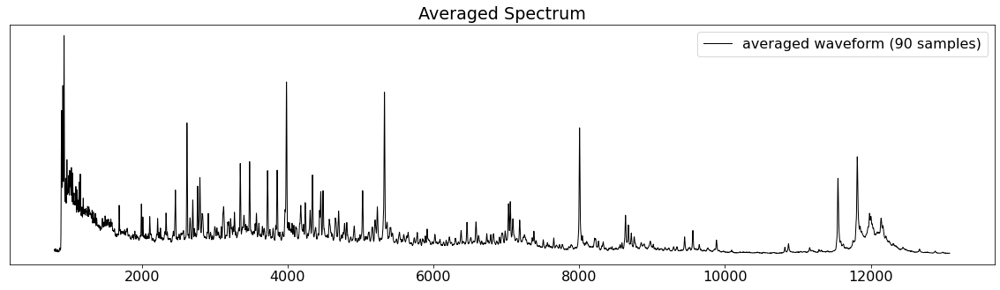

In [4]:
io.Draw_Average (X, X_names, SD = 0)

# draw_averaged_waveform(X, X_names)

# 3. Dimensionality Reduction Evaluation

`pip install pyMFDR` or `pip install qsi-tk`      
pyMFDR is currently integrated into qsi-tk. `qsi.dr.mf` and `pyMFDR.mfdr` are equal.

In [5]:
from qsi.dr import mf
mf.get_algorithms()

# OR
# from pyMFDR import mfdr
# mfdr.get_algorithms()

Using TensorFlow backend.
C:\Users\eleve\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\eleve\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\eleve\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\eleve\anaconda3\lib\site-packages\tensorflow\python\framework\dtypes.py

['PCA', 'NMF', 'LAE', 'RP', 'SRP', 'VQ', 'AA', 'ICA']

# 4. MF-based DR Algorithms

## 4.1 PCA

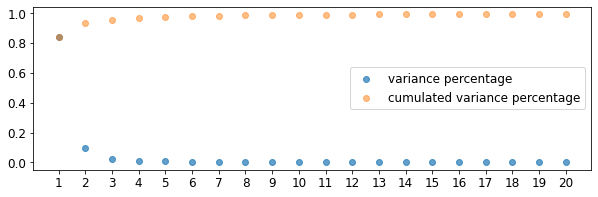

In [6]:
W,H,Xr,o = mf.mf(X, 20, alg = 'PCA', display = True)

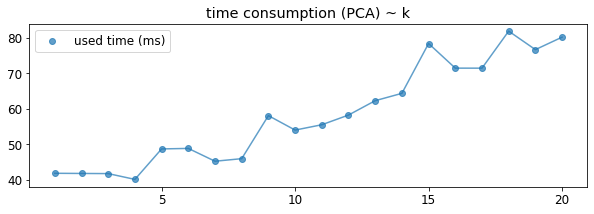

[41.886833333333335,
 41.84062222222222,
 41.798588888888894,
 40.16964444444445,
 48.746477777777784,
 48.8907,
 45.28234444444444,
 46.00288888888889,
 58.12583333333334,
 54.051022222222215,
 55.55254444444444,
 58.28212222222223,
 62.32848888888889,
 64.39526666666666,
 78.4281,
 71.49195555555555,
 71.4831111111111,
 81.91086666666666,
 76.7044,
 80.21545555555556]

In [7]:
mf.measure_time(X, alg = 'PCA', display = True, repeat = 11)

In [8]:
k = 3 # elbow
print('explained variance ratio:', o.explained_variance_ratio_[0:k]) 

explained variance ratio: [0.84193569 0.09399705 0.02030708]


--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


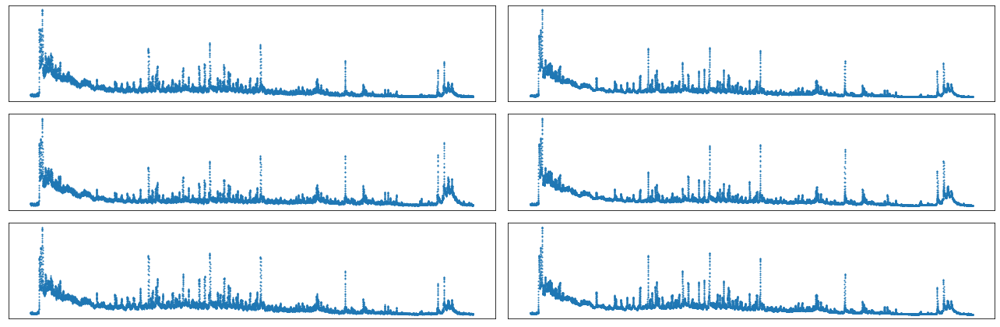

rMSE =  0.009629658790479298
--- Distance Matrices (D and Dz) ---


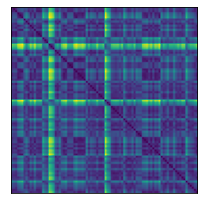

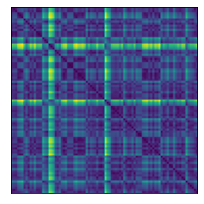

Residual Variance (using Pearson's r) =  0.0024452676917121607
Residual Variance (using Spearman's r) =  0.006250820715046235
--- Ranking Matrices (R and Rz) ---


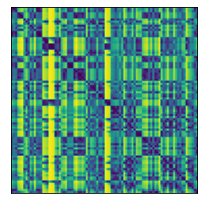

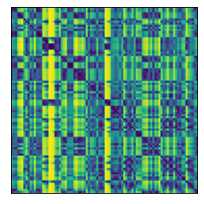

--- Co-ranking Matrix (Q) ---


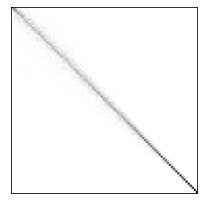

--- Trustworthiness T(k) and Continuity C(k) ---


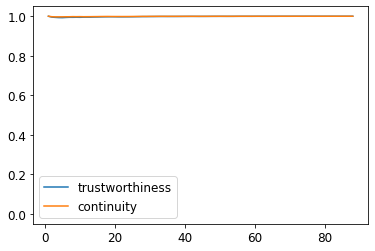

AUC of T =  0.9984460091416465
AUC of C =  0.999311971680936
--- QNN(k) Curve ---


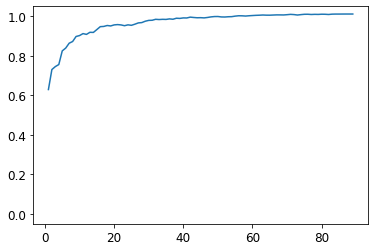

AUC of QNN =  0.9671967710421049
--- LCMC(k) Curve ---


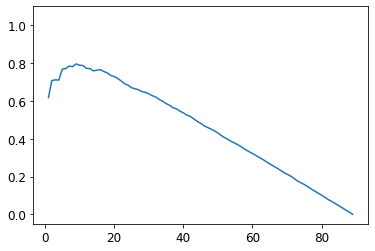

kmax (0-based index) =  8
Qlocal =  0.7952821869488536
Qglobal =  0.9851170618774393


In [10]:
W,H,Xr,o = mf.mf(X, 3, alg = 'PCA', display = False)
mf.evaluate_dr(X,W,Xr)

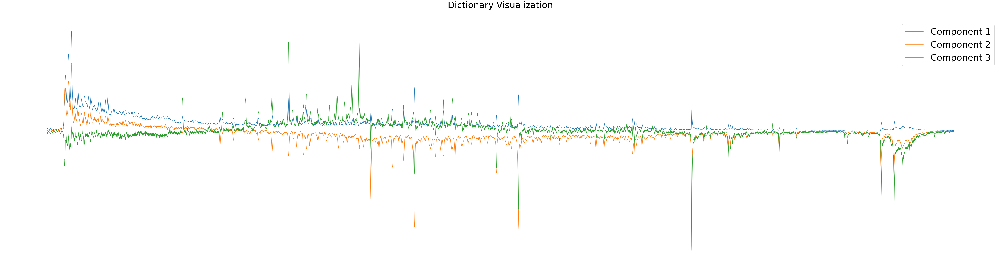

In [12]:
mf.visualize_dictionary(H)

X[0]


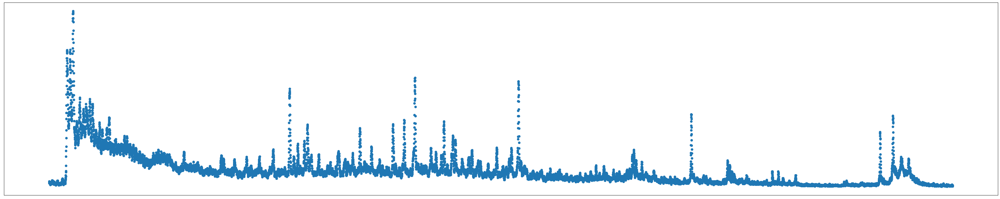

Xr[0]


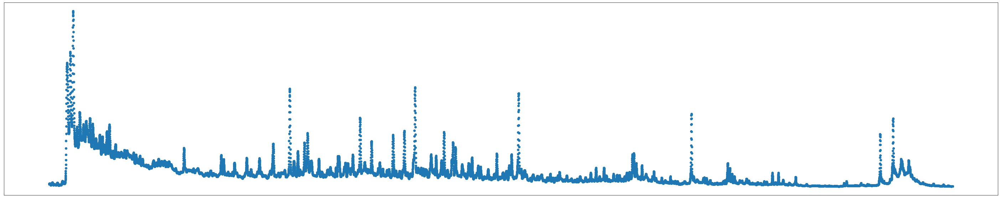

In [13]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

## 4.2 NMF (Non-negative Matrix Factorization)

NMF requires non-negative input. Use X_mm_scaled, other than X_scaled


Objective: Find two non-negative matrices (W, H) whose product approximates the non-negative matrix X. This factorization can be used for example for dimensionality reduction, source separation or topic extraction.

The cost function is:
$$
J(W, H) = ||X - WH||_F^2 + \lambda \alpha (||W||_1 + ||H||_1) + {1 \over 2} \lambda (1-\alpha)(||W||_F^2 + ||H||_F^2) 
$$
    Where:

Frobenius norm of Matrix A:
$$
        ||A||_F =\sqrt { \sum_{i,j} A_{ij}^2 }
$$
Elementwise L1 norm of Matrix A:
$$
        ||A||_1 = \sum_{i,j} |A_{ij}| 
$$

J is minimized with an alternating minimization of W and H. The training algorithm stops the iteration when the set tolerance of error is reached.

C:\Users\eleve\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
C:\Users\eleve\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
C:\Users\eleve\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
C:\Users\eleve\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
C:\Users\eleve\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1641: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  ConvergenceWarning,
C:\Us

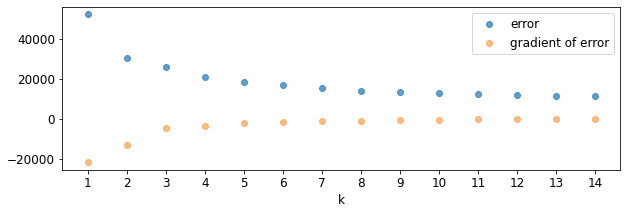

In [14]:
_ = mf.mf(X, 3, alg = 'NMF', display = True)

Elbow method: choose K = 3

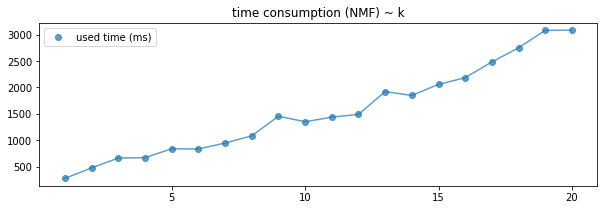

[276.1411777777778,
 475.4321111111111,
 662.1323888888888,
 668.6625111111111,
 836.933711111111,
 834.3484888888888,
 946.2168111111109,
 1083.0188555555555,
 1454.8962444444444,
 1350.1336222222221,
 1437.8945666666666,
 1488.9151,
 1920.9024333333332,
 1848.3022777777778,
 2057.959588888889,
 2185.8603222222223,
 2483.0788555555555,
 2752.8048888888893,
 3083.350566666666,
 3086.6569666666664]

In [15]:
mf.measure_time(X, alg = 'NMF', display = True, repeat = 11)

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


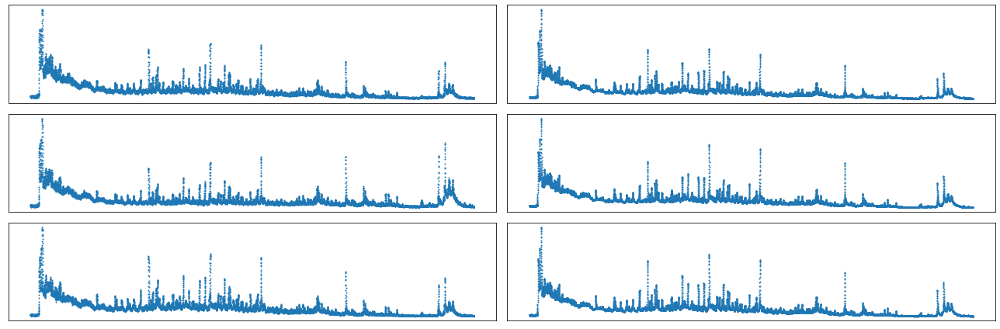

rMSE =  0.012246691109922936
--- Distance Matrices (D and Dz) ---


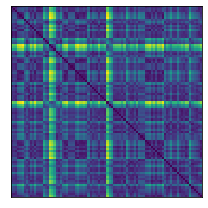

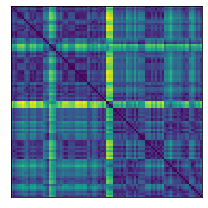

Residual Variance (using Pearson's r) =  0.30396310919588365
Residual Variance (using Spearman's r) =  0.3767797642174776
--- Ranking Matrices (R and Rz) ---


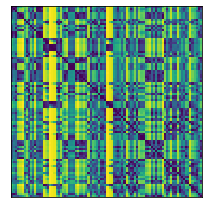

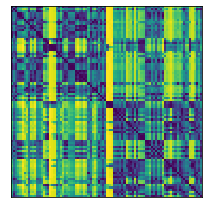

--- Co-ranking Matrix (Q) ---


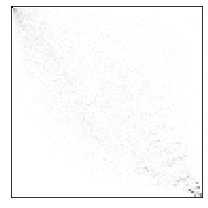

--- Trustworthiness T(k) and Continuity C(k) ---


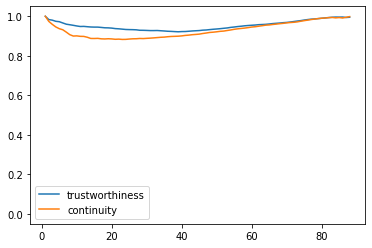

AUC of T =  0.9528748447629912
AUC of C =  0.9300389722418753
--- QNN(k) Curve ---


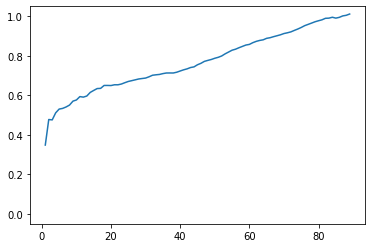

AUC of QNN =  0.7678370818829847
--- LCMC(k) Curve ---


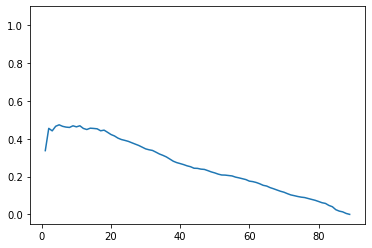

kmax (0-based index) =  4
Qlocal =  0.46861423220973786
Qglobal =  0.7799229791682436


In [16]:
W,H,Xr,o = mf.mf(X, 3, alg = 'NMF', display = False)
mf.evaluate_dr(X,W,Xr)

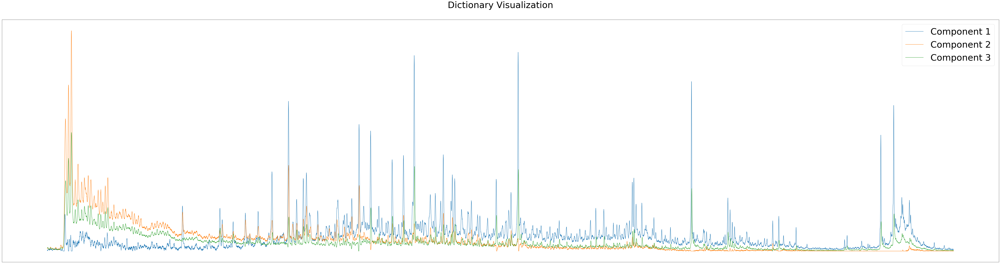

In [17]:
mf.visualize_dictionary(H)

X[0]


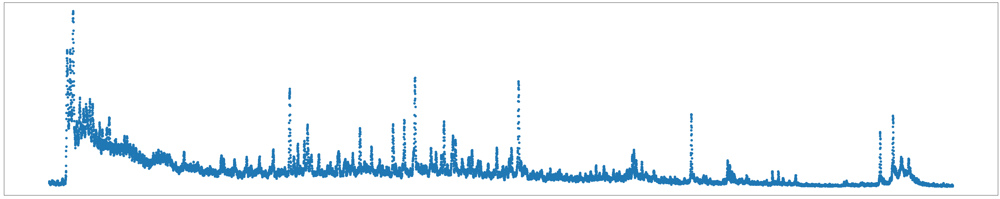

Xr[0]


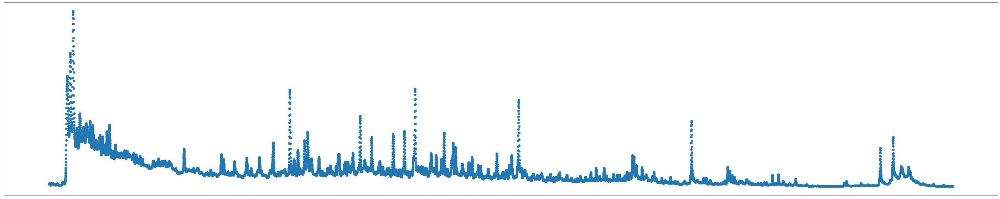

In [18]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

## 4.3 AutoEncoder

An autoencoder, is an artificial neural network used for learning efficient codings.   
The aim of an autoencoder is to learn a representation (encoding) for a set of data, typically for the purpose of dimensionality reduction. 


An autoencoder is unsupervised since it's not using labeled data. The goal is to minimize reconstruction error based on a loss function, such as the mean squared error:

<p>$\mathcal{L}(\mathbf{x},\mathbf{x'})=\|\mathbf{x}-\mathbf{x'}\|^2=\|\mathbf{x}-f(\mathbf{W'}(f(\mathbf{Wx}+\mathbf{b}))+\mathbf{b'})\|^2$</p>

f is activation function, e.g. relu, sigmoid
<hr/>

**AutoEncoder (as well as other NN models, such as MLP) is sensitive to feature scaling, so it is highly recommended to scale your data.**

**Trouble Shooting:**  

> tensorflow.python.framework.errors_impl.InternalError: Blas GEMM launch failed  
> GPU sync failed   

**Solution: Make sure no other processes use the GPU. Run nvidia-smi to check this.**

### 4.4.2 Auto encoder without activation (linear activation)

$\mathcal{L}(\mathbf{x},\mathbf{x'})=\|\mathbf{x}-\mathbf{x'}\|^2=\|\mathbf{x}-\mathbf{W'}(\mathbf{Wx}+\mathbf{b})-\mathbf{b'}\|^2$

NN requires feature scaling


Train on 72 samples, validate on 18 samples
Epoch 1/200
72/72 [==============================] - 1s 13ms/step - loss: 6.3019 - val_loss: 2.3013
Epoch 2/200
72/72 [==============================] - 0s 2ms/step - loss: 1.9211 - val_loss: 1.5474
Epoch 3/200
72/72 [==============================] - 0s 2ms/step - loss: 1.7819 - val_loss: 1.5383
Epoch 4/200
72/72 [==============================] - 0s 1ms/step - loss: 1.7892 - val_loss: 1.5642
Epoch 5/200
72/72 [==============================] - 0s 2ms/step - loss: 1.7991 - val_loss: 1.5603
Epoch 6/200
72/72 [==============================] - 0s 1ms/step - loss: 1.8060 - val_loss: 1.5732
Epoch 7/200
72/72 [==============================] - 0s 1ms/step - loss: 1.8138 - val_loss: 1.5819


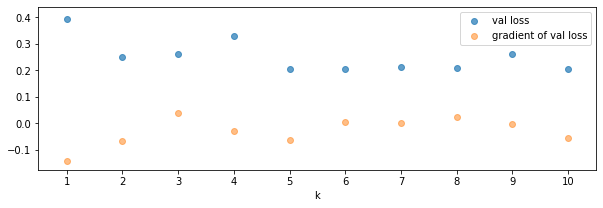

In [19]:
W,H,Xr,o = mf.mf(X, 3, alg = 'LAE', display = True, verbose = 1)

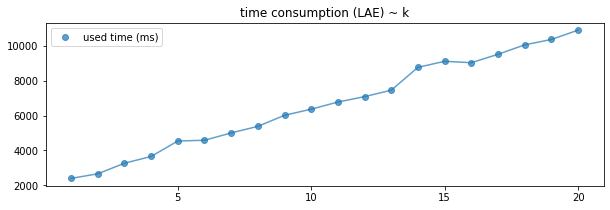

[2403.326466666667,
 2665.240033333333,
 3270.9975,
 3659.2204,
 4541.101466666667,
 4585.403,
 5004.3728666666675,
 5381.403600000001,
 6013.8625,
 6364.2389,
 6772.795166666667,
 7081.099466666667,
 7450.826033333334,
 8756.977333333334,
 9103.427533333333,
 9022.472833333333,
 9504.489366666667,
 10043.332833333332,
 10351.9249,
 10886.236233333335]

In [20]:
mf.measure_time(X, alg = 'LAE', display = True, r = list(range(1, 21)))

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


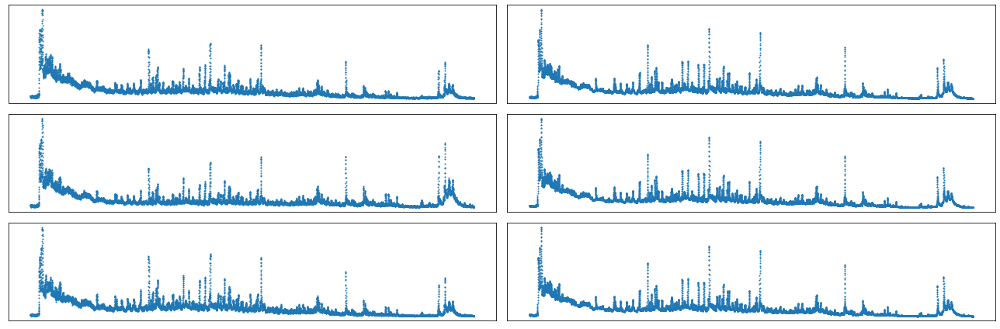

rMSE =  0.21994860866711466
--- Distance Matrices (D and Dz) ---


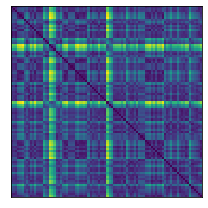

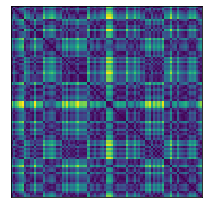

Residual Variance (using Pearson's r) =  0.499951518530626
Residual Variance (using Spearman's r) =  0.48213161493708456
--- Ranking Matrices (R and Rz) ---


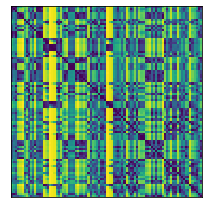

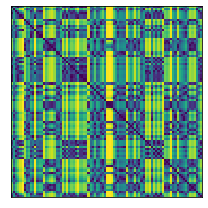

--- Co-ranking Matrix (Q) ---


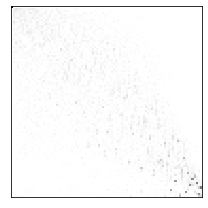

--- Trustworthiness T(k) and Continuity C(k) ---


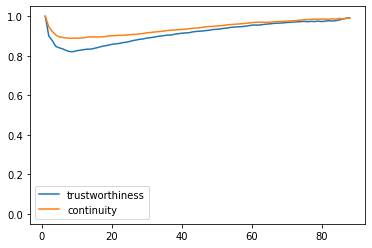

AUC of T =  0.9168207047193714
AUC of C =  0.9417073347816576
--- QNN(k) Curve ---


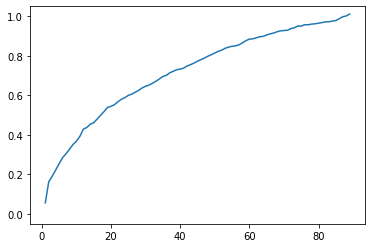

AUC of QNN =  0.7188827441412506
--- LCMC(k) Curve ---


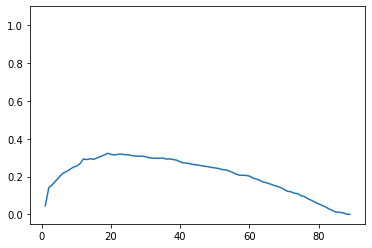

kmax (0-based index) =  18
Qlocal =  0.35429704373690296
Qglobal =  0.8110916988450716


In [21]:
mf.evaluate_dr(X,W,Xr)

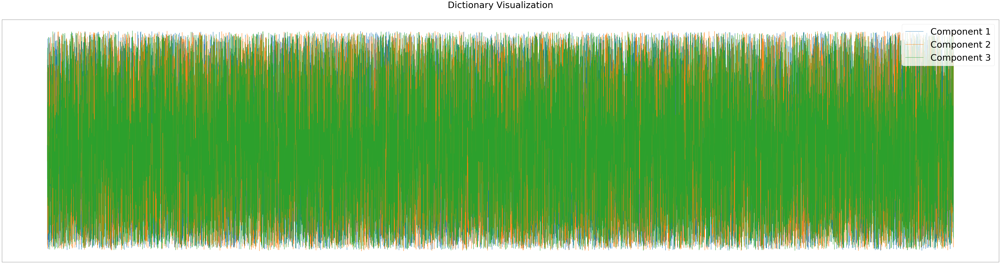

In [22]:
mf.visualize_dictionary(H)

A single layer auto encoder with linear transfer function is nearly equivalent to PCA, where nearly means that the H found by AE and PCA won't be the same--but the subspace spanned by the respective H's will.

X[0]


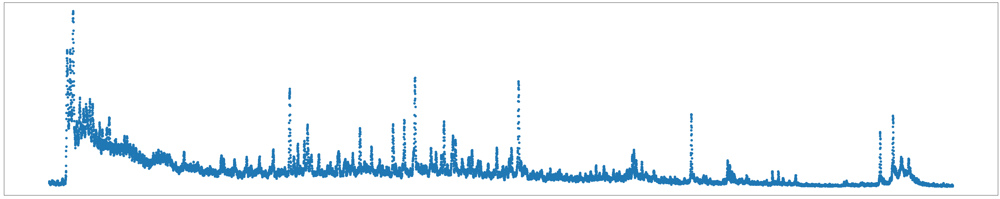

Xr[0]


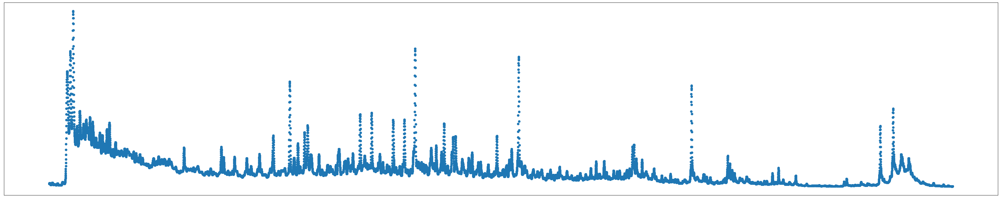

In [23]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

## 4.4 Random Projection (RP)

In RP, a higher dimensional data is projected onto a lower-dimensional subspace using a random matrix whose columns have unit length. Benefits: 
1. RP is computationally efficient, yet accurate enough for this purpose as it does not introduce a significant distortion in the data.
2. It is not sensitive to impulse noise. So RP is promising alternative to some existing methods in noise reduction (like mean filtering) too.
3. Data independent or non-adaptive. 
4. Can use even if we can't access all data.  

### Gaussian random projection

project the original input space on a randomly generated matrix where components are drawn from the $N (0, {1 \over \sqrt(k)} )$ distribution.
For RP, if unspecified, k will be auto generated by Johnson-Lindenstrauss lemma, at eps = 0.1 (smaller eps has better embedding quality)

In [24]:
from sklearn.random_projection import johnson_lindenstrauss_min_dim
johnson_lindenstrauss_min_dim(n_samples=len(X), eps=[0.1, 0.5, 0.99])

array([3856,  215,  108])

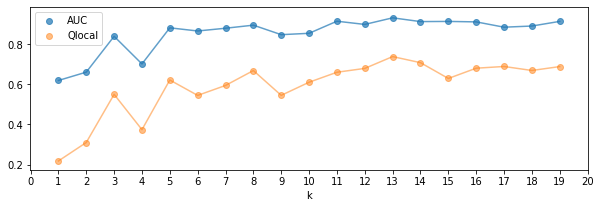

In [16]:
W,H,Xr,o = mf.mf(X, 'auto', alg = 'RP', display = True) # due to randomness, each run may vary slightly

In [26]:
W.shape, H.shape, Xr.shape

((90, 3856), (3856, 16383), (90, 16383))

Best k at 6. Below we use k = 3 to compare with others.

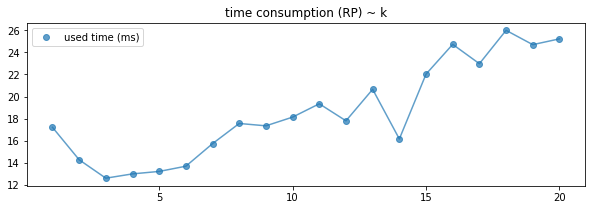

[17.208652631578946,
 14.265605263157894,
 12.5929,
 12.982926315789474,
 13.206647368421052,
 13.679673684210526,
 15.726394736842105,
 17.5568,
 17.34224210526316,
 18.133273684210526,
 19.342531578947366,
 17.79741052631579,
 20.653347368421056,
 16.151536842105266,
 22.032378947368418,
 24.733489473684212,
 22.977736842105266,
 26.005215789473684,
 24.70683157894737,
 25.23123684210526]

In [27]:
mf.measure_time(X, alg = 'RP', display = True, repeat = 21)

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


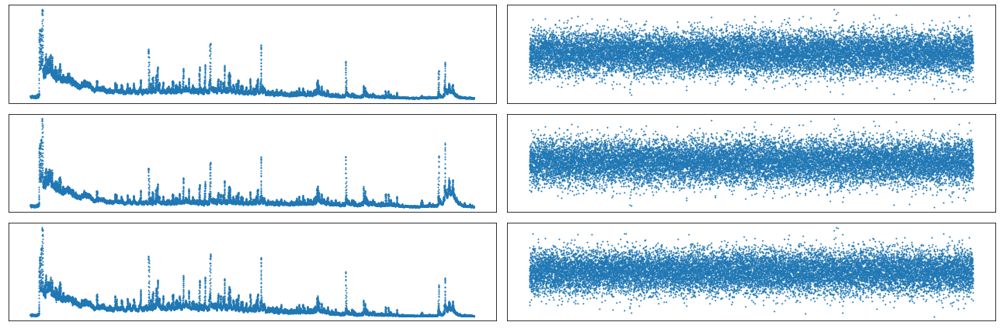

rMSE =  1113.7708417602014
--- Distance Matrices (D and Dz) ---


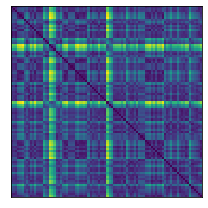

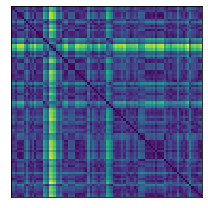

Residual Variance (using Pearson's r) =  0.25710618316527534
Residual Variance (using Spearman's r) =  0.39479265066761837
--- Ranking Matrices (R and Rz) ---


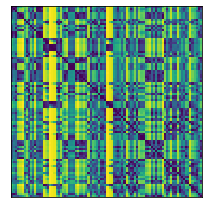

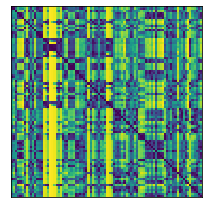

--- Co-ranking Matrix (Q) ---


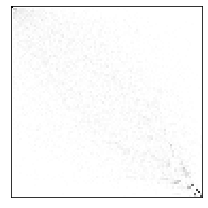

--- Trustworthiness T(k) and Continuity C(k) ---


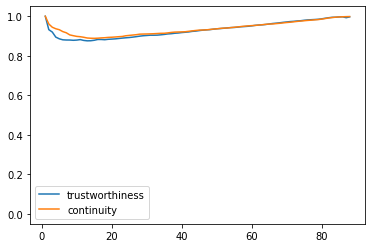

AUC of T =  0.9314456736775214
AUC of C =  0.9376869764365278
--- QNN(k) Curve ---


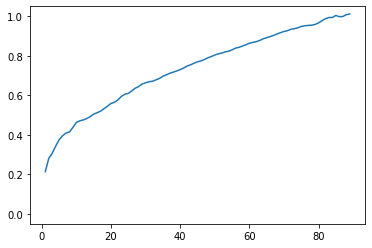

AUC of QNN =  0.7342049373267835
--- LCMC(k) Curve ---


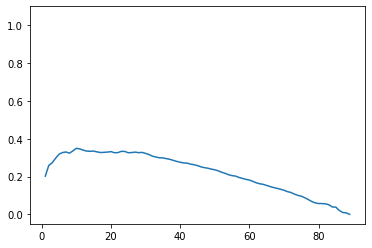

kmax (0-based index) =  9
Qlocal =  0.3639365971107544
Qglobal =  0.7741336562561345


In [28]:
W,H,Xr,o = mf.mf(X, 3, alg = 'RP', display = False)
mf.evaluate_dr(X,W,Xr)

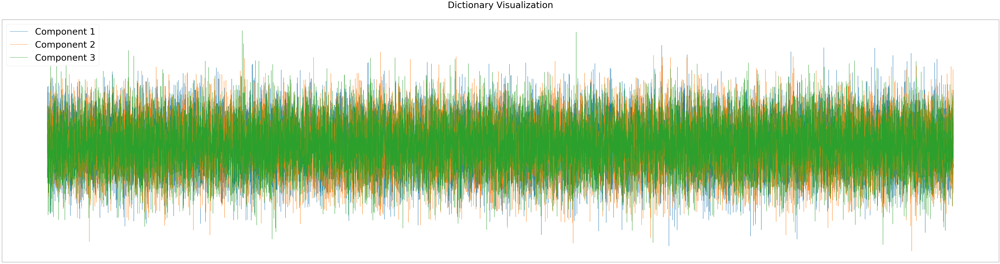

In [29]:
mf.visualize_dictionary(H)

X[0]


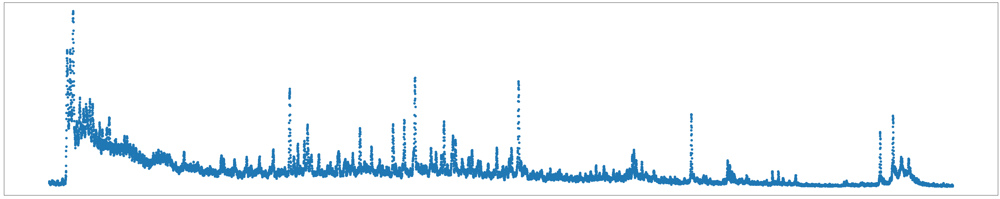

Xr[0]


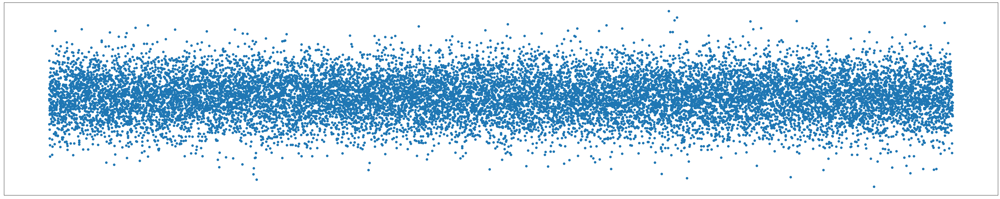

In [30]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

We can verify the distributions of the component loadings. Theoretically, they are drawn from $N (0, {1 \over \sqrt(k)} )$

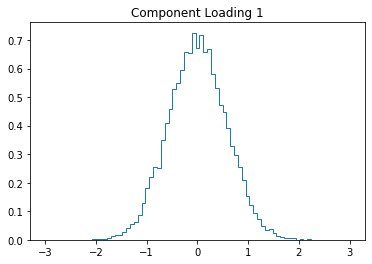

mu =  -0.003 std =  0.575


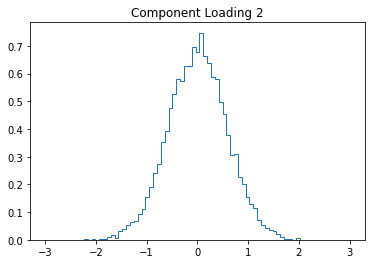

mu =  -0.001 std =  0.581


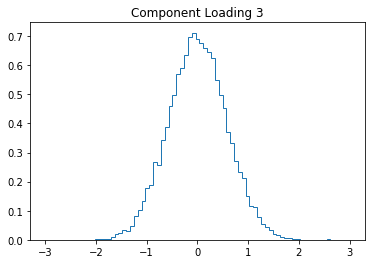

mu =  -0.001 std =  0.577


In [31]:
mf.visualize_dictionary_distribution(H)

Even though the distance matrix (pair-wise distances) is kept, the reconstruction is horrible, as the H of RP is randomly sampled from Gaussian distributions and little information of the original signal is kept.  
H of RP is random/stocastic. Accurate reconstruction is almost impossible.

### Sparse random projection

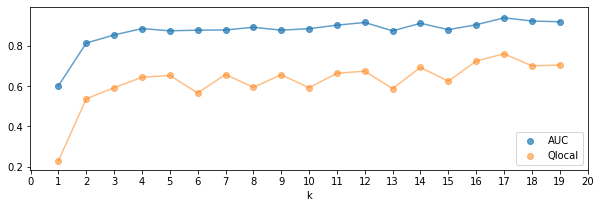

((90, 3856), (3856, 16383), (90, 16383))

In [10]:
W,H,Xr,o = mf.mf(X, 'auto', alg = 'SRP', display = True)  # due to randomness, each run may vary slightly
W.shape, H.shape, Xr.shape

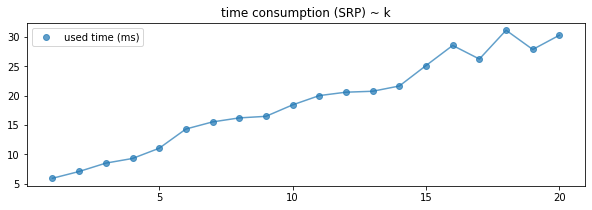

[5.948915789473685,
 7.103715789473684,
 8.524831578947369,
 9.314347368421052,
 11.052557894736843,
 14.316505263157895,
 15.527894736842104,
 16.20887894736842,
 16.47529473684211,
 18.422731578947367,
 20.000389473684212,
 20.577042105263157,
 20.736800000000002,
 21.631447368421053,
 25.10385789473684,
 28.52373157894737,
 26.210936842105262,
 31.10572631578948,
 27.838152631578946,
 30.263621052631578]

In [33]:
mf.measure_time(X, alg = 'SRP', display = True, repeat = 21)

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


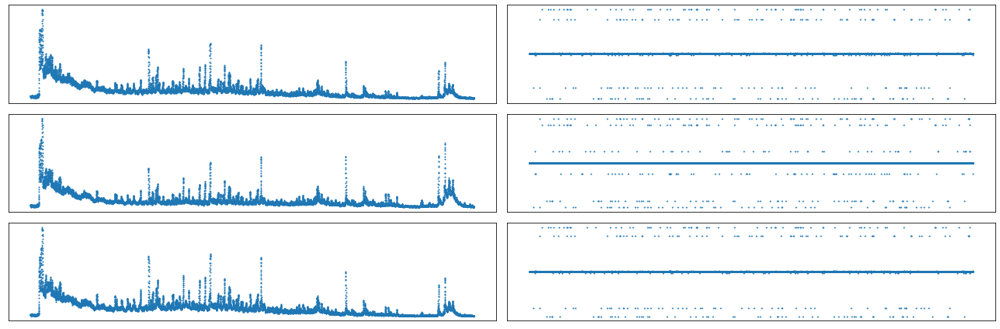

rMSE =  3000.04308747207
--- Distance Matrices (D and Dz) ---


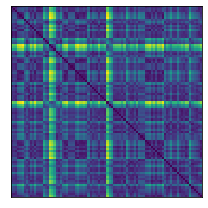

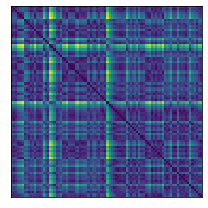

Residual Variance (using Pearson's r) =  0.17064048544938326
Residual Variance (using Spearman's r) =  0.28373331710436567
--- Ranking Matrices (R and Rz) ---


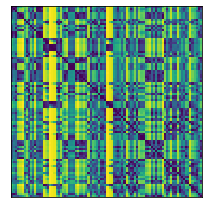

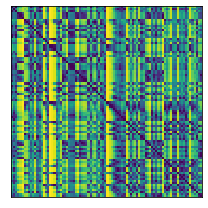

--- Co-ranking Matrix (Q) ---


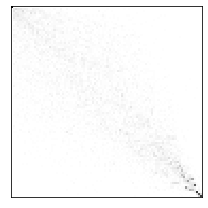

--- Trustworthiness T(k) and Continuity C(k) ---


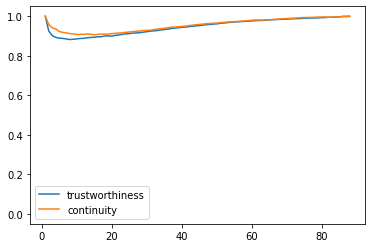

AUC of T =  0.9474962968211581
AUC of C =  0.9555959064467487
--- QNN(k) Curve ---


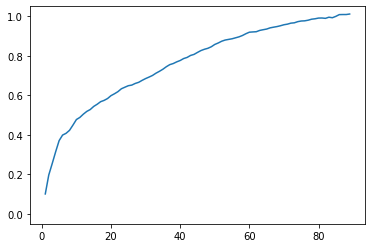

AUC of QNN =  0.7636151598342902
--- LCMC(k) Curve ---


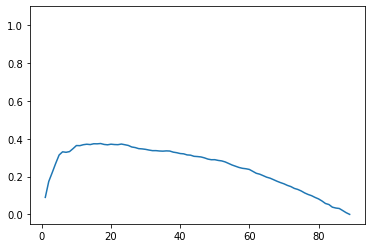

kmax (0-based index) =  16
Qlocal =  0.41765158690822546
Qglobal =  0.8391414235049895


In [34]:
W,H,Xr,o = mf.mf(X, 3, alg = 'SRP', display = False)
mf.evaluate_dr(X,W,Xr)

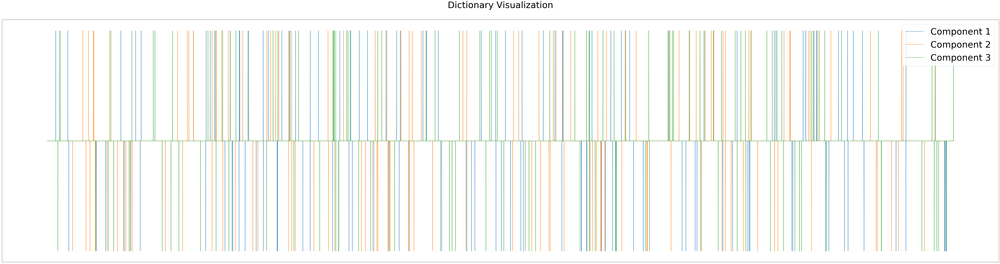

In [35]:
mf.visualize_dictionary(H)

X[0]


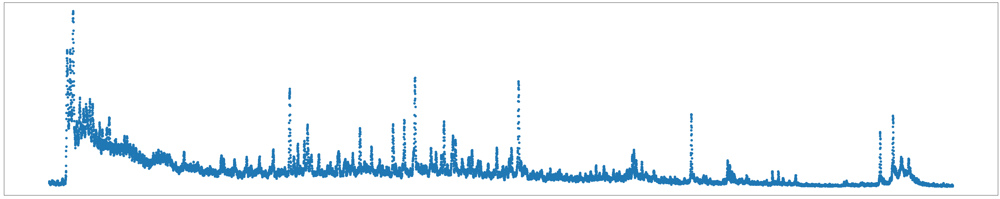

Xr[0]


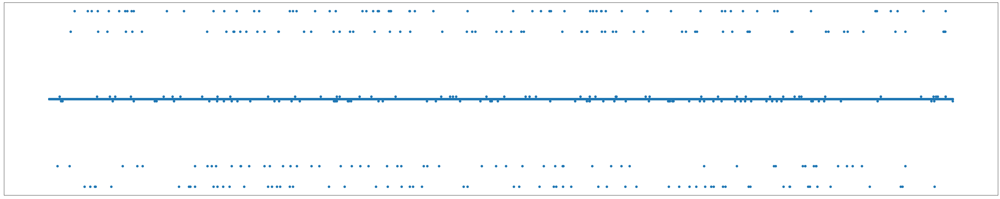

In [36]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

The component loadings of SRP should be "sparse". We can check it:

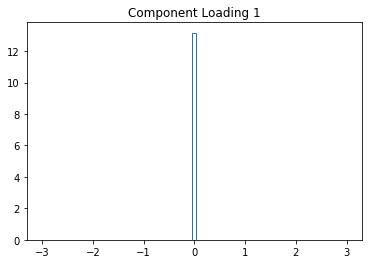

mu =  -0.004 std =  0.568


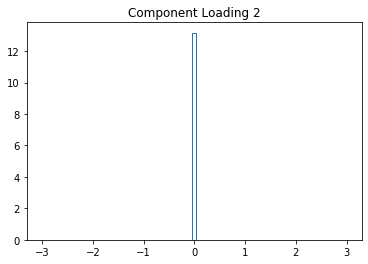

mu =  -0.002 std =  0.582


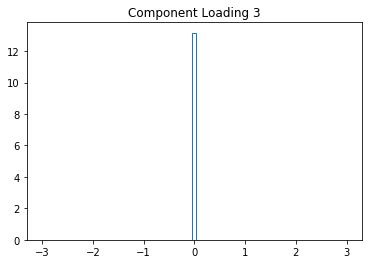

mu =  0.007 std =  0.566


In [37]:
mf.visualize_dictionary_distribution(H, dist = None)

# 4.8 Vector Quantization

The K-means algorithms is the specialization of the Lloyd I quantization algorithm.

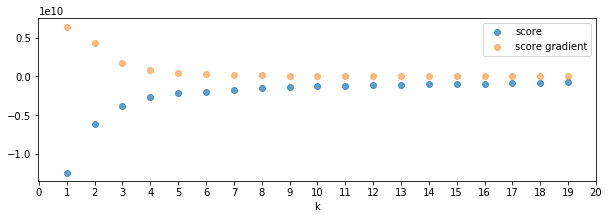

In [38]:
_ = mf.mf(X, 3, alg = 'VQ', display = True)

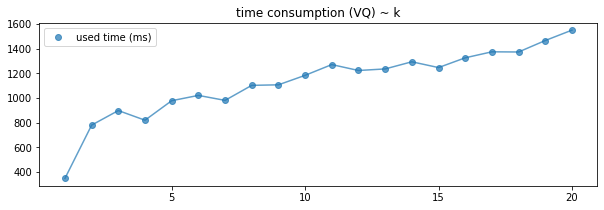

[346.66693333333325,
 779.1971666666667,
 897.4124,
 818.9763333333334,
 977.3337,
 1020.4253333333332,
 979.9976,
 1102.0003333333334,
 1106.3338333333334,
 1183.3318000000002,
 1270.6666333333333,
 1222.6671666666664,
 1235.3326,
 1293.3337666666666,
 1246.3227666666667,
 1325.6663333333333,
 1374.2925666666667,
 1372.9196333333332,
 1465.9363999999998,
 1550.3255000000001]

In [39]:
mf.measure_time(X, alg = 'VQ', display = True)

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


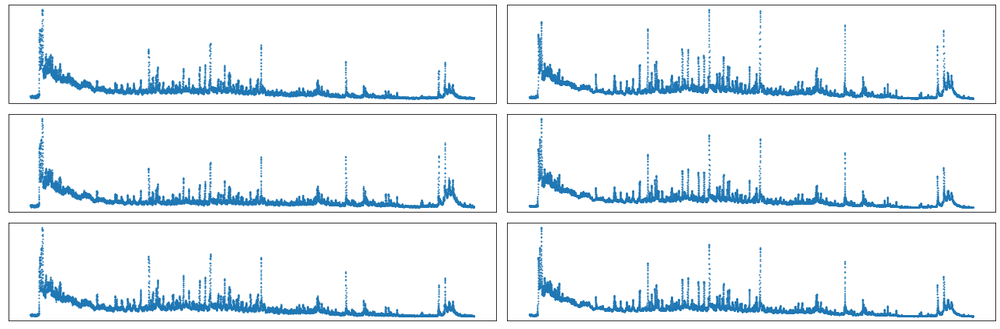

rMSE =  0.06654239005356875
--- Distance Matrices (D and Dz) ---


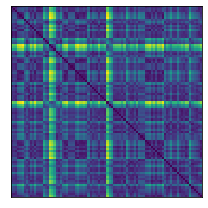

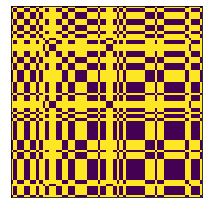

Residual Variance (using Pearson's r) =  0.701502312146971
Residual Variance (using Spearman's r) =  0.6168812504838155
--- Ranking Matrices (R and Rz) ---


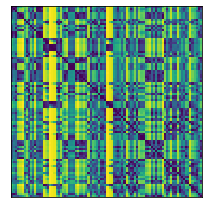

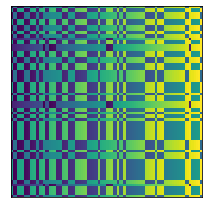

--- Co-ranking Matrix (Q) ---


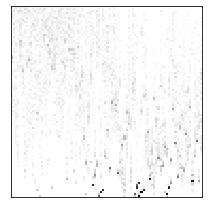

--- Trustworthiness T(k) and Continuity C(k) ---


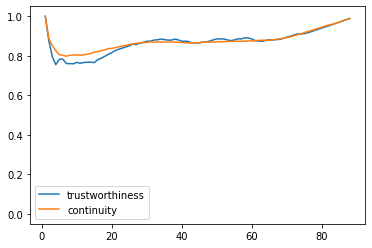

AUC of T =  0.8688356287902141
AUC of C =  0.8750785424553293
--- QNN(k) Curve ---


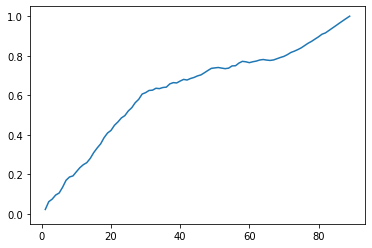

AUC of QNN =  0.6259472795756004
--- LCMC(k) Curve ---


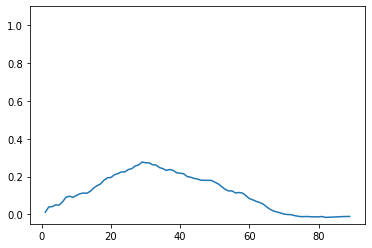

kmax (0-based index) =  28
Qlocal =  0.3172176135314993
Qglobal =  0.7686016453791756


In [8]:
W,H,Xr,o = mf.mf(X, 3, alg = 'VQ', display = False)
mf.evaluate_dr(X,W,Xr)

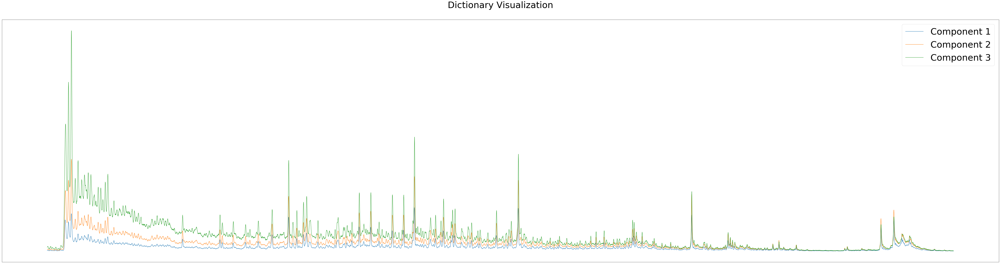

In [9]:
mf.visualize_dictionary(H)

X[0]


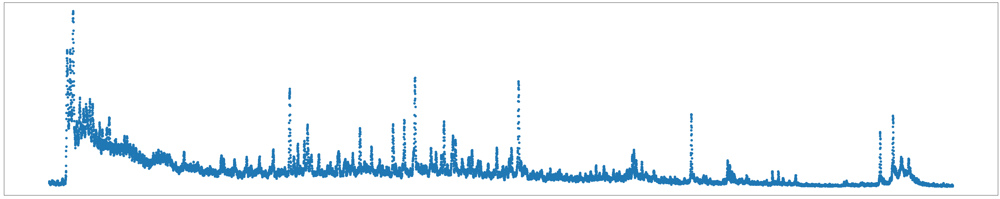

Xr[0]


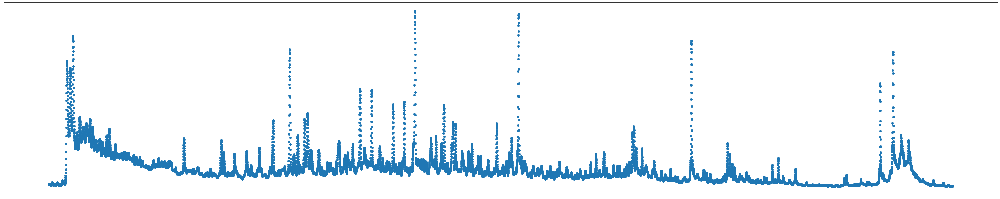

In [10]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

## 4.9 Archetypal Analysis

Bauckhage, Christian & Kersting, Kristian & Hoppe, Florian & Thurau, Christian. (2015). Archetypal Analysis as an Autoencoder：

"Archetypal analysis is a matrix factorization method specically conceived for
latent factor analysis [8]. Since it allows for dimensionality reduction and sparse
coding alike, it is applicable to feature extraction, clustering, or classication [3].
Contrary to related approaches, latent factors or archetypes found through
archetypal analysis characterize extremes rather than averages. Archetypes do
not rely on implicit density assumptions such as, for example, eigenvectors or
cluster centroids which are tailored towards globally or locally Gaussian data.
Rather, archetypal analysis introduces a form of symmetry into latent factor
modeling: archetypes are convex combinations (see [Convex Hull.ipynb]) of data points and data points are
explained as of convex combinations of archetypes.
It is therefore faithful to the nature of data. For instance, archetypes of
non-negative data will be non-negative, too. Also, since archetypes are convex
combinations of actual data, they closely resemble certain data points and thus
do not require reication when interpreted.
"

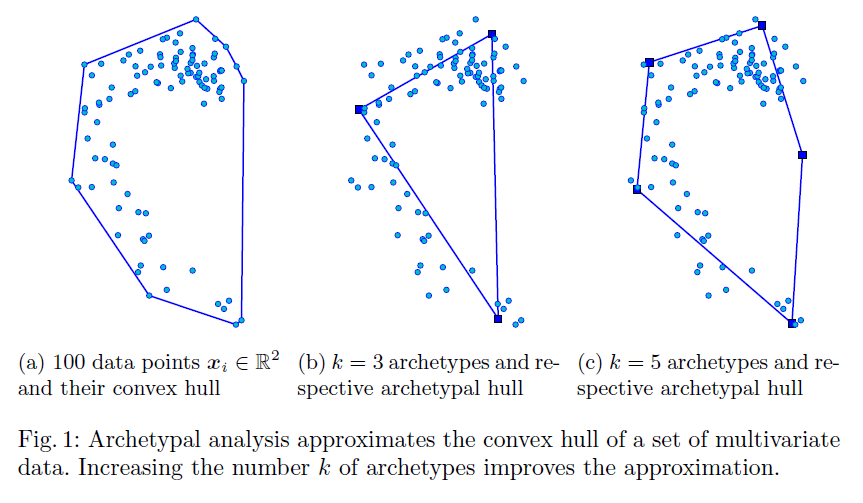

    - Archetypal Analysis as an Autoencoder


"lies somewhere between decomposition and clustering. For example, if the observations are grouped by the closest archetype, archetypal analysis can be used in clustering problems"

    Note: There is a python package `pip install archetypes`. However, we found this implementation throws error, and you need to remove the code line from the src file: 

        X = self._validate_data(X, dtype=[np.float64, np.float32])

    It also doesn't have `explained_variance_` field. 

We use the archetypes package developed in DATA61 (CSIRO). https://data.csiro.au/collection/csiro:40600v1

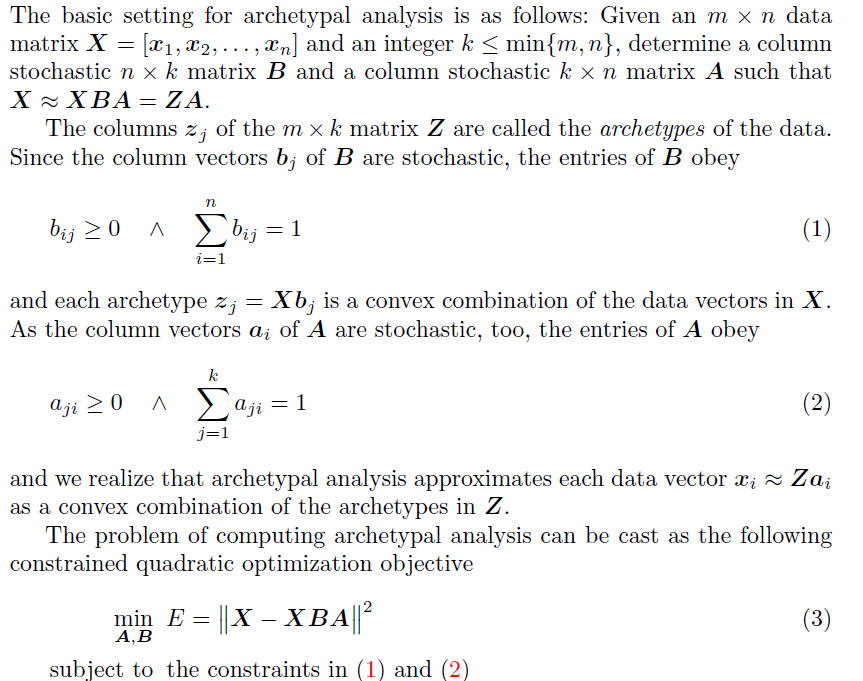

以上，Z = XB 对应于下式的 W，为潜空间的稀疏表示；A 对应 H，为字典

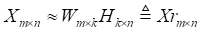

### Description of arguments

    n_archetypes:   Defines the number of archetypes.
    n_dim:          Number of features (Dimensions).
    n_data:         Number of data in dataset.
    
    X:              
        Dimension:  n_dim x n_data
        
                    Array of data points. It is the transpose of input data.
                    
    
    archetypes:
        
        Dimension:  n_dim x n_archetypes
        
                    Array of archetypes. Each columns represents an archetype.
    
        
    alfa:
        Dimension:  n_archetypes x n_data
        
                    Each column defines the weight coefficients for each 
                    archetype to approximate data point i.
                    Xi = sum([alfa]ik x Zk)
    
    beta:
        Dimension:  n_data x n_archetypes
        
                    Each column defines the weight coefficients for each data 
                    point from which archetype k is constructed.
                    

Becareful X is n x m. Need to transpose X.

**n_archetypes**: defines how many archetypes will be extracted. A positive integer. Note n_archetypes = 1 would return the mean of the data set (see "Archetpye Analysis" by Adele Cutler and Leo Breiman, Technometrics, November 1994, Vol.36, No.4, pp. 338-347.) <br><br>
**tolerance**: defines when to stop optimisation. It checks convergence of residual sum of squares (RSS) <br>
**max_iter**:       maximum number of iterations for optmisation. <br><br>
**random_state**:   random seed number. <br><br>
**C**:              the weight on the constraint equation. Smaller is the weight, stronger is the constraint. Constraint Eq.: $$\sum\alpha = 1,$$ $$\sum\beta = 1$$

**initialize**: three different initialization techniques are implemented:
- 'random': randomly selects a set of archetypes from the feature space. 
- 'random_idx': randomly selects a set of data points as initial archetypes.
- 'furthest_sum': Uses the furthest sum to efficiently initialize the archetypes. The idea is taken from a recent paper: Archetypal analysis for machine learning and data mining, Morten Morup and Lars Kai Hansen. 

**redundancy_try**: Depending on the initialisation, the set of archetypes may be redundant. Once redundancy occurs, alfa values corresponding to the redundant archetype becomes zero. In such circumstance, the algorithm searches for new candidate point to resolve redundancy. redundancy_try controls the number of tries by the algorithm to resolve redundancy. If not resolved, algorithm reduces the number of archetypes. For details on this issue, refer to "Archetpye Analysis" by Adele Cutler and Leo Breiman, Technometrics, November 1994, Vol.36, No.4, pp. 338-347.

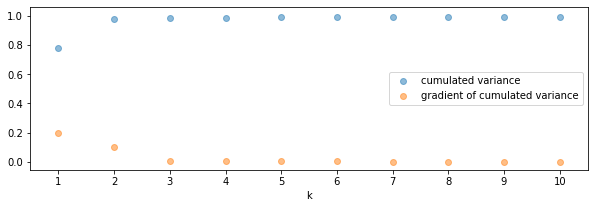

In [43]:
W,H,Xr,o = mf.mf(X, 3, alg = 'AA', display = True)

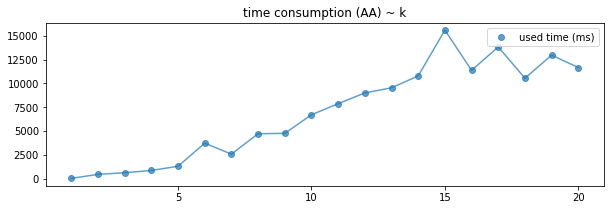

[15.6523,
 439.6008,
 611.9064,
 847.0509,
 1293.2058,
 3718.8829,
 2563.3641,
 4710.9285,
 4745.9071,
 6703.3829,
 7869.4491,
 9000.1756,
 9533.3042,
 10788.4092,
 15596.9677,
 11371.5039,
 13832.2197,
 10541.4405,
 12968.3309,
 11660.0083]

In [44]:
mfdr.measure_time(X[:,0::20], alg = 'AA', display = True, repeat = 1) # AA is time consuming, we downsample it to 1/20

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


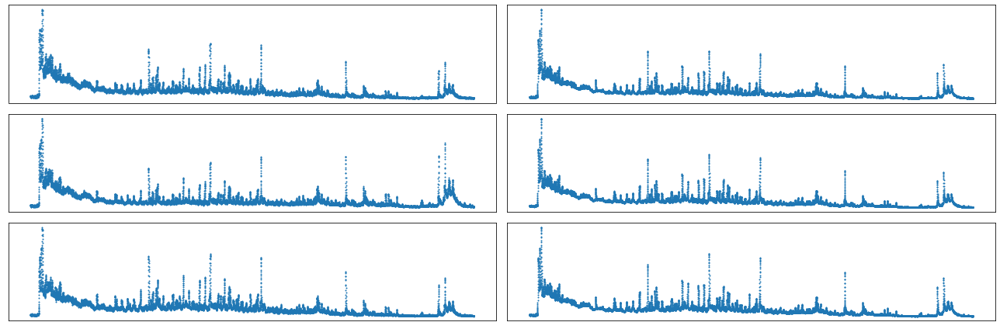

rMSE =  0.015883986894893422
--- Distance Matrices (D and Dz) ---


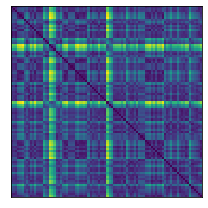

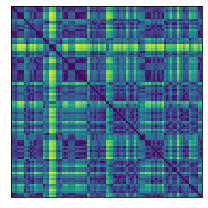

Residual Variance (using Pearson's r) =  0.20460111227819988
Residual Variance (using Spearman's r) =  0.18919591372603006
--- Ranking Matrices (R and Rz) ---


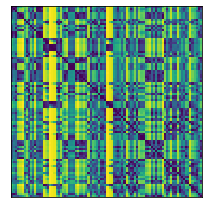

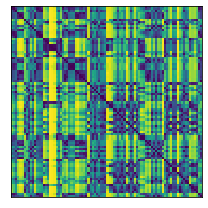

--- Co-ranking Matrix (Q) ---


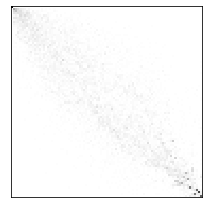

--- Trustworthiness T(k) and Continuity C(k) ---


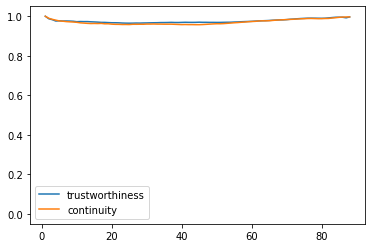

AUC of T =  0.9758012150617641
AUC of C =  0.9713149122354516
--- QNN(k) Curve ---


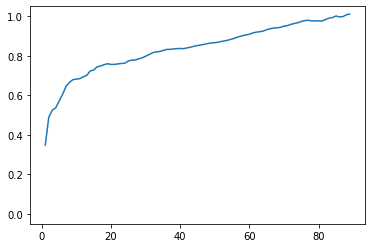

AUC of QNN =  0.8363753806224741
--- LCMC(k) Curve ---


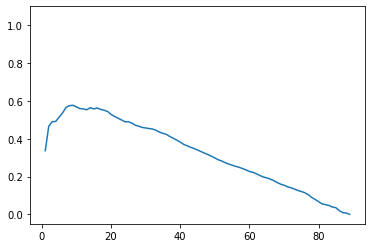

kmax (0-based index) =  8
Qlocal =  0.5626379723758002
Qglobal =  0.8630197778766918


In [45]:
mf.evaluate_dr(X,W,Xr)

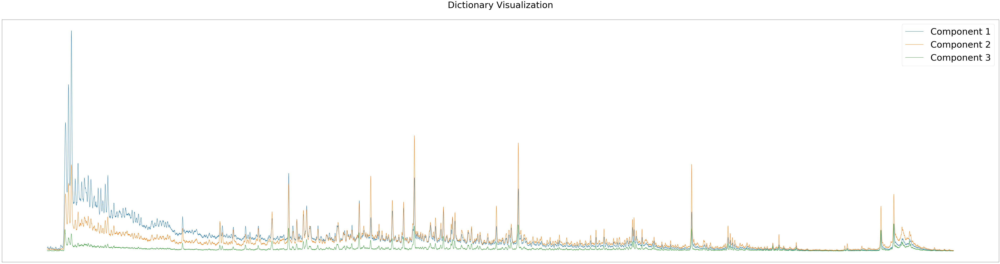

In [46]:
mfdr.visualize_dictionary(H)

X[0]


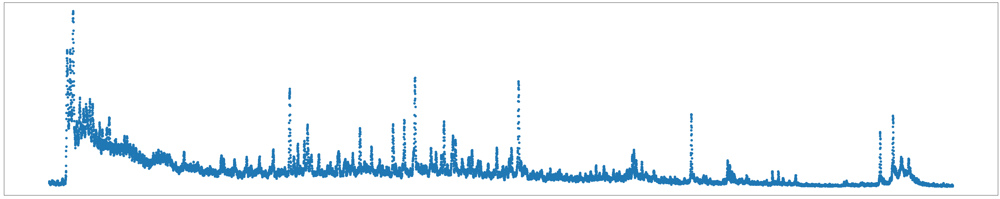

Xr[0]


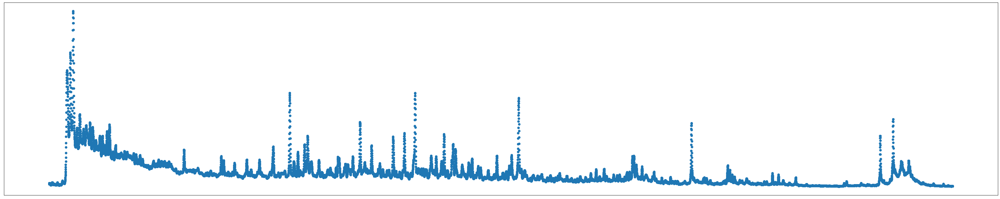

In [47]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

### Simplex Plot (a.k.a. Ternary Diagram): Mapping datapoints to archetype convex hull

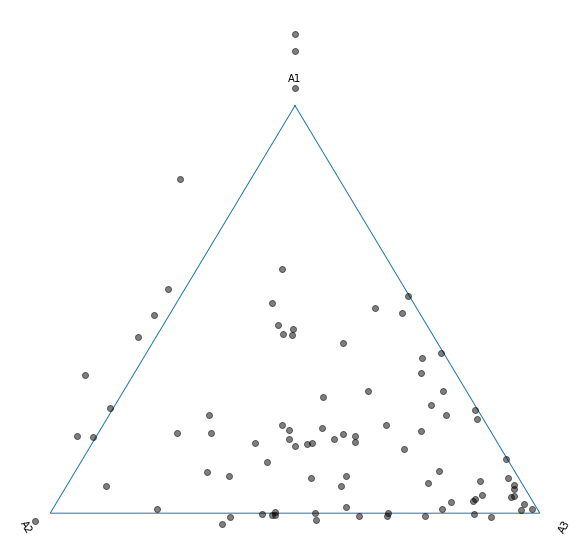

In [48]:
o.plot_simplex(o.alfa)

C:\Users\eleve\anaconda3\lib\site-packages\pyMFDR\archetypes.py:708: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(111, polar=True)
C:\Users\eleve\anaconda3\lib\site-packages\pyMFDR\archetypes.py:708: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(111, polar=True)


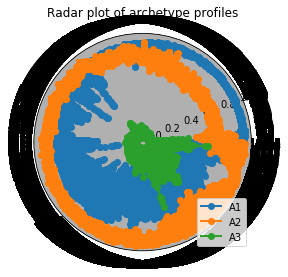

In [49]:
o.plot_radar_profile(feature_cols = None, Title = 'Radar plot of archetype profiles')

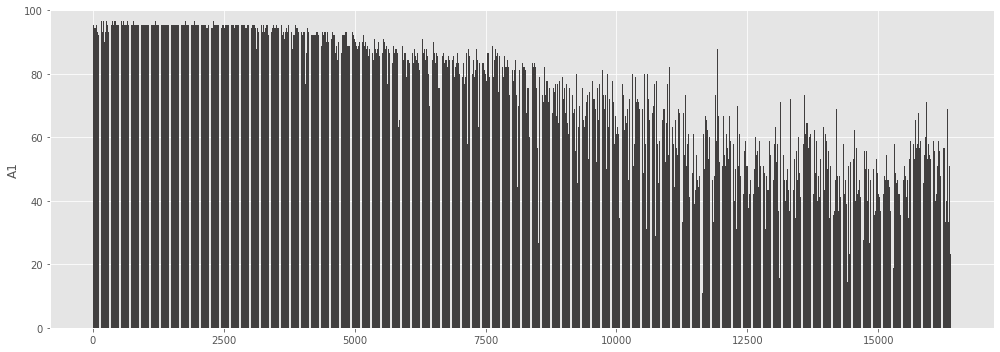

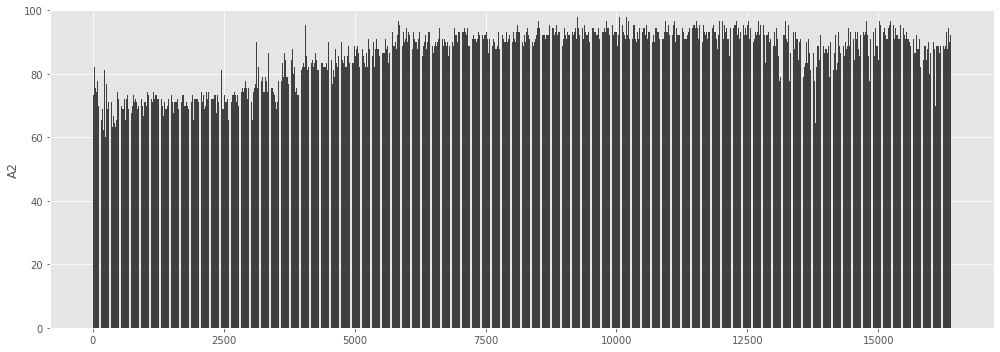

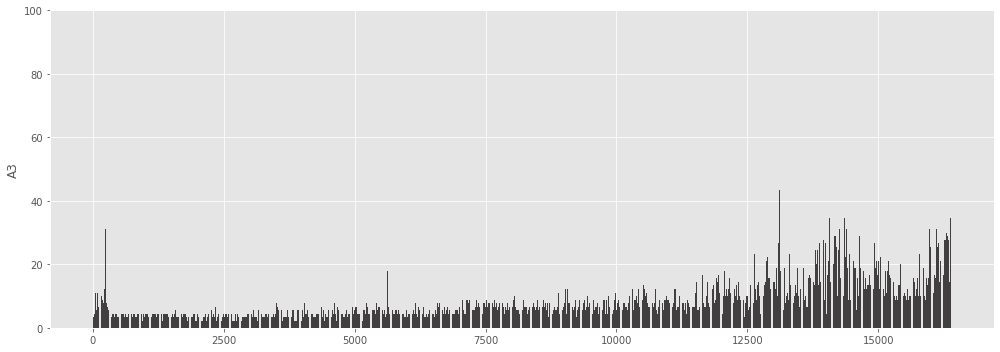

In [50]:
o.plot_profile()

### Finding the most archetypal data points in the set

Attribute .close_match contains the most archetypal data points. This attribute is a dictionary where the keys are the archetypes. The first item in the tuple gives the index of the data point. The second item is the corresponding 𝛼 array of that data point. Alfa can used to map the data point to a simplex plot or display it on a radar plot. It also shows how archetypal the data point is. 

In [51]:
o._extract_closes_match()
o.close_match

{1: (20, array([1.06376666, 0.        , 0.        ])),
 2: (58, array([0.06847161, 0.85537964, 0.08195074])),
 3: (31, array([0.        , 0.        , 0.93356303]))}

### Radar plot of archetypal data points in archetype space

It shows the most archetypal data points. As seen, each is inclined toward one archetype.

C:\Users\eleve\anaconda3\lib\site-packages\pyMFDR\archetypes.py:750: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(111, polar=True)
C:\Users\eleve\anaconda3\lib\site-packages\pyMFDR\archetypes.py:750: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = fig.add_subplot(111, polar=True)


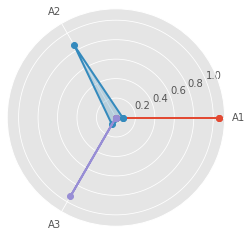

In [52]:
o.plot_close_match(Title='')

In [53]:
plt.style.use('default')

## Application in Style Transfer

Unsupervised Learning of Artistic Styles with Archetypical Style Analysis. NeurIPS 2018 - Annual Conference on Neural Information Processing Systems,
Dec 2018, Montréal, Canada. pp.1-10. 

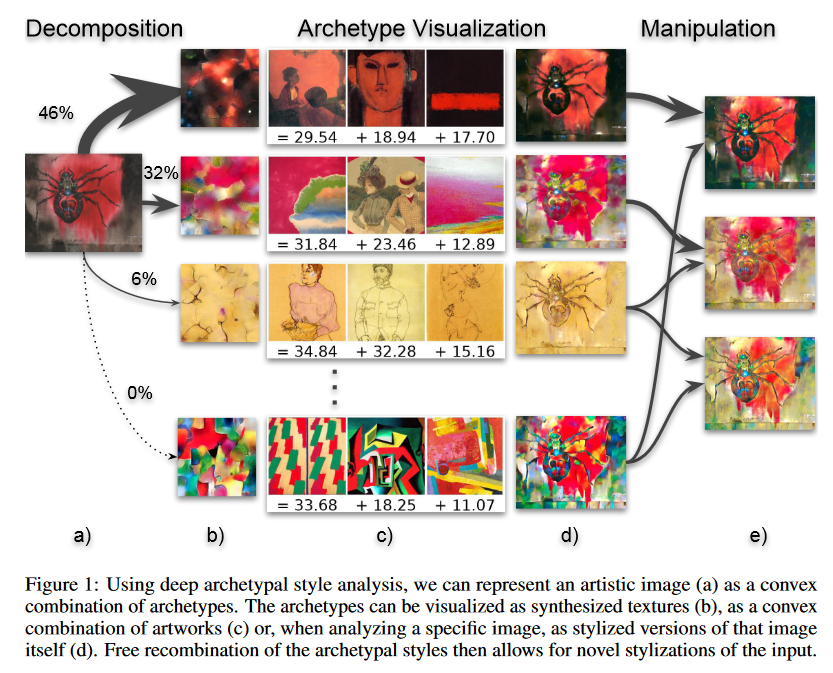

## 4.10 ICA

ICA is a common BSS (Blind Source Separation) alogrithm. Its goal is to separate a multivariate signal into additive subcomponents. Its foundamental assumption is "independence". ICA aims to finds k independent latent components (z1, z2 ...) by maximizing their statistical independence. 
According to the original paper of ICA, the latent sources (denoted as s1 and s2) must be indepedent. i.e., their pdfs (probability density functions) should meet: 
∫p(s1, s2)ds2 = p(s1) and vice verse. The joint pdf: p(s1, s2) = p1(s1)p2(s2).
And E(g(s1)g(s2)] = E(g(s1))E(g(s2)), g is any function defined on s1 and s2.



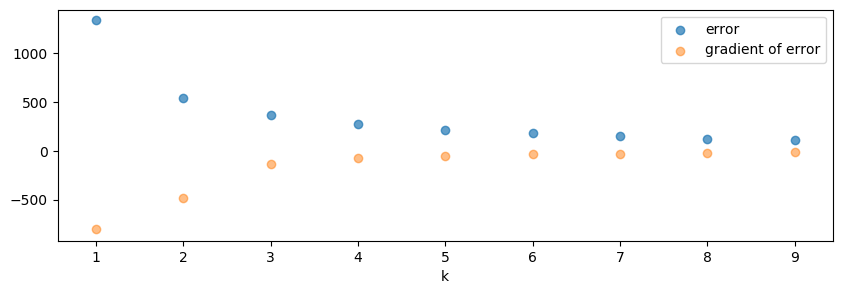

In [54]:
W,H,Xr,o = mf.mf(X, 3, alg = 'ICA', display = True)

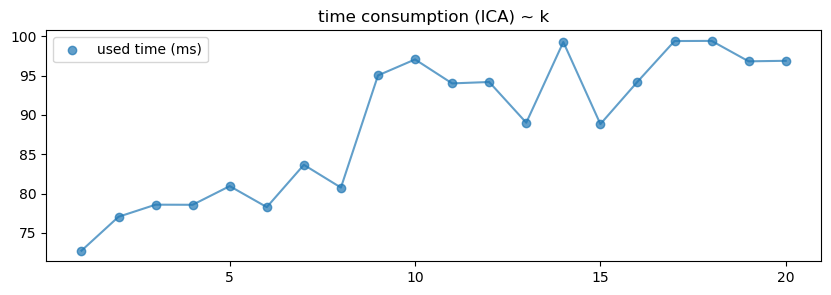

[72.73100000000001,
 77.04263333333334,
 78.5809,
 78.56706666666666,
 80.94109999999999,
 78.27,
 83.65013333333333,
 80.75193333333334,
 95.01763333333334,
 97.05123333333334,
 94.00363333333333,
 94.18076666666667,
 89.00663333333334,
 99.26486666666666,
 88.83143333333334,
 94.20800000000001,
 99.38913333333333,
 99.41003333333333,
 96.80936666666666,
 96.8775]

In [55]:
mf.measure_time(X, alg = 'ICA', display = True)

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


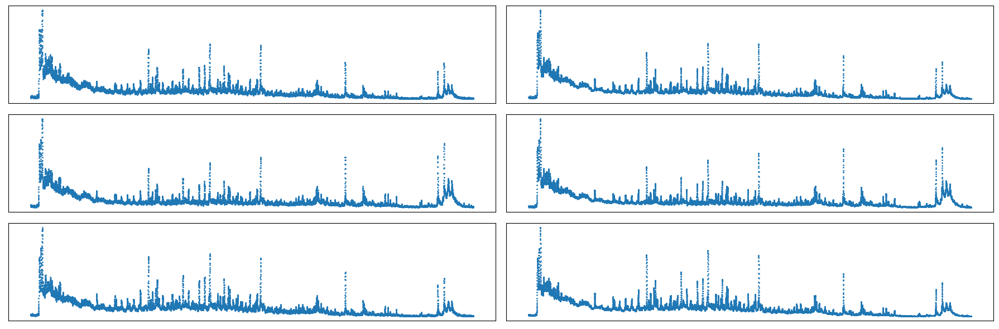

rMSE =  0.0029171485251560892
--- Distance Matrices (D and Dz) ---


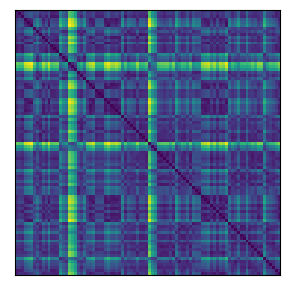

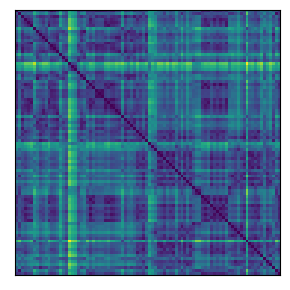

Residual Variance (using Pearson's r) =  0.40250711214990076
Residual Variance (using Spearman's r) =  0.4495365334394468
--- Ranking Matrices (R and Rz) ---


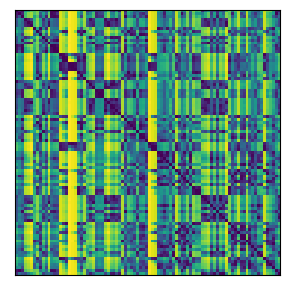

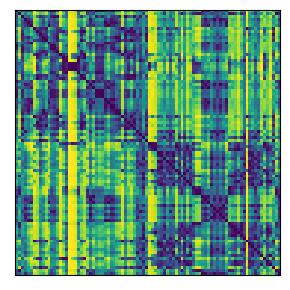

--- Co-ranking Matrix (Q) ---


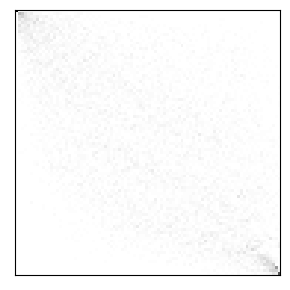

--- Trustworthiness T(k) and Continuity C(k) ---


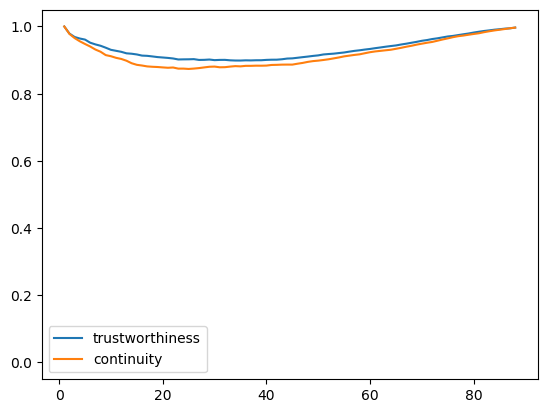

AUC of T =  0.9336685452729209
AUC of C =  0.9191529888761153
--- QNN(k) Curve ---


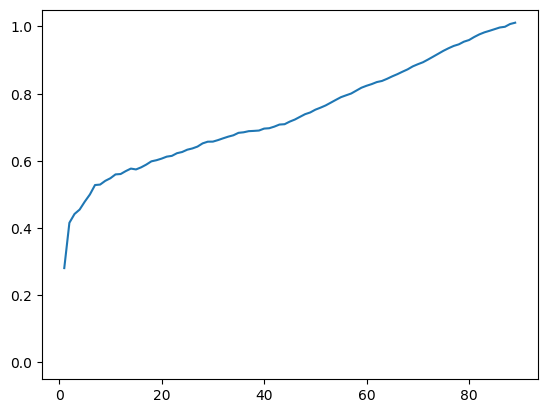

AUC of QNN =  0.7372260773687422
--- LCMC(k) Curve ---


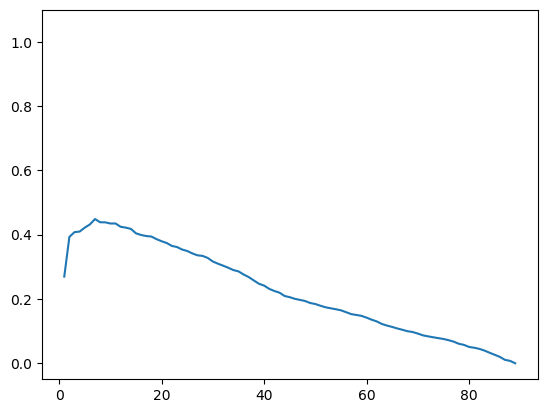

kmax (0-based index) =  6
Qlocal =  0.4429106474050294
Qglobal =  0.7564585400800868


In [56]:
mf.evaluate_dr(X,W,Xr)

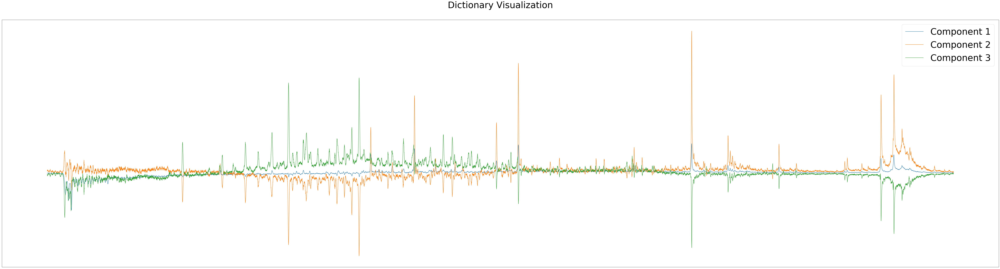

In [57]:
mf.visualize_dictionary(H)

X[0]


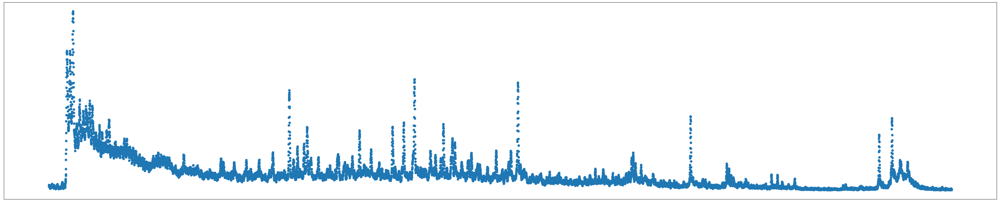

Xr[0]


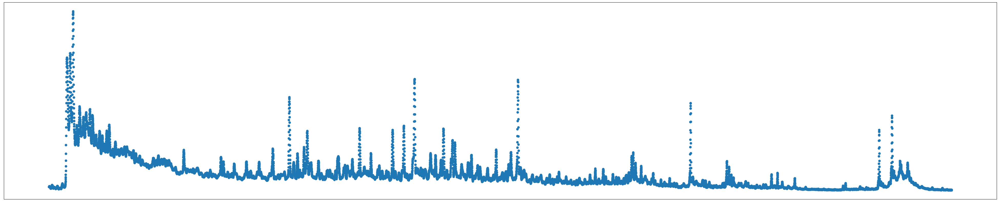

In [58]:
mf.visualize_one_sample_reconstruction(X, Xr) # high-res image for 1st sample reconstruction

In [59]:
np.corrcoef ( o.components_ , rowvar = True) # Unlike PCA, after ICA, correlation is not necessary 0 for every two sources, i.e., not orthogonal.

array([[ 1.        ,  0.42013904,  0.14467506],
       [ 0.42013904,  1.        , -0.78275271],
       [ 0.14467506, -0.78275271,  1.        ]])

# Appendix

## Other relevant packages:  

1. pip install pyAMNESIA

    Methods
        Dimensionality reduction
            PCA
            Autoencoder
        Source separation
            ICA
            NMF
        
2. pip install Factorization. Focus on parallelization of MF.
3. Many are targeted towards recommender systems, e.g., pip install matrix-factorization  
       
Benefits of pyMFDR:  
1. more MF algorithms,   
2. benchmark/comparison tools (DR quality metrics).

## Hardware

In [83]:
!pip install psutil

In [76]:
import psutil
import platform

def get_size(bytes, suffix="B"):
    """
    Scale bytes to its proper format
    e.g:
        1253656 => '1.20MB'
        1253656678 => '1.17GB'
    """
    factor = 1024
    for unit in ["", "K", "M", "G", "T", "P"]:
        if bytes < factor:
            return f"{bytes:.2f}{unit}{suffix}"
        bytes /= factor

print("="*40, "System Information", "="*40)
uname = platform.uname()
print(f"System: {uname.system}")
print(f"Node Name: {uname.node}")
print(f"Release: {uname.release}")
print(f"Version: {uname.version}")
print(f"Machine: {uname.machine}")
print(f"Processor: {uname.processor}")

# let's print CPU information
print("="*40, "CPU Info", "="*40)
# number of cores
print("Physical cores:", psutil.cpu_count(logical=False))
print("Total cores:", psutil.cpu_count(logical=True))
# CPU frequencies
cpufreq = psutil.cpu_freq()
print(f"Max Frequency: {cpufreq.max:.2f}Mhz")
print(f"Min Frequency: {cpufreq.min:.2f}Mhz")

svmem = psutil.virtual_memory()
print(f"Total Memory: {get_size(svmem.total)}")

swap = psutil.swap_memory()
print(f"Total Swap: {get_size(swap.total)}")

======================================== System Information ========================================
System: Windows
Node Name: ROG
Release: 10
Version: 10.0.22000
Machine: AMD64
Processor: Intel64 Family 6 Model 158 Stepping 10, GenuineIntel
======================================== CPU Info ========================================
Physical cores: 6
Total cores: 12
Max Frequency: 2208.00Mhz
Min Frequency: 0.00Mhz
Total Memory: 15.85GB
Total Swap: 27.10GB
======================================== GPU Details ========================================
[('NVIDIA GeForce GTX 1070 with Max-Q Design', '8192.0MB')]


In [82]:
# GPU information. The AE(autoencoder) uses gpu, cuda, cudnn, tf and keras.

print("="*40, "GPU Details", "="*40)

!nvidia-smi

from tensorflow.python.platform import build_info as tf_build_info
print('CUDA', tf_build_info.cuda_version_number)
print('CuDNN', tf_build_info.cudnn_version_number)

======================================== GPU Details ========================================
Tue Apr 19 21:03:54 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 472.12       Driver Version: 472.12       CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A    0C    P8    11W /  N/A |    110MiB /  8192MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+------------------

<hr/>
<br/><br/><br/><br/><br/><br/><br/>
<hr/>

# Other DR algorithms

100%|█████████████████████████████████████████████████████████████████████████████████| 21/21 [00:00<00:00, 672.75it/s]


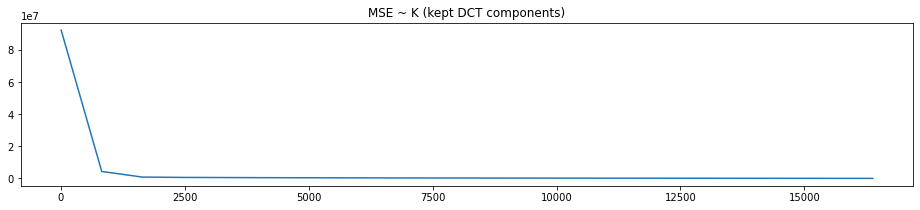

In [2]:
from qsi import dr

dr.dct(X[0], flavor = 'fftpack')

Cut x to be even length. OpenCV DCT & IDCT input requires even dimensions.


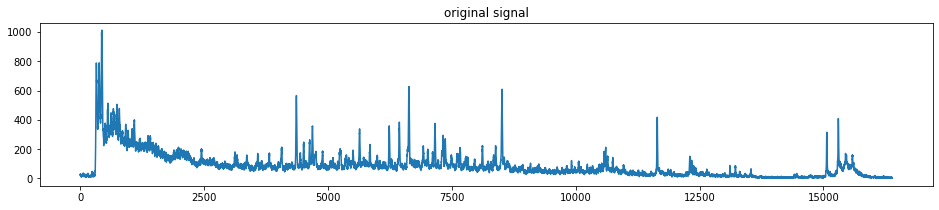

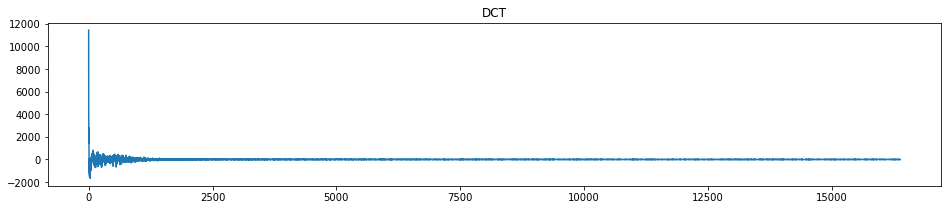

1000  /  16382  =  0.06104260774020266


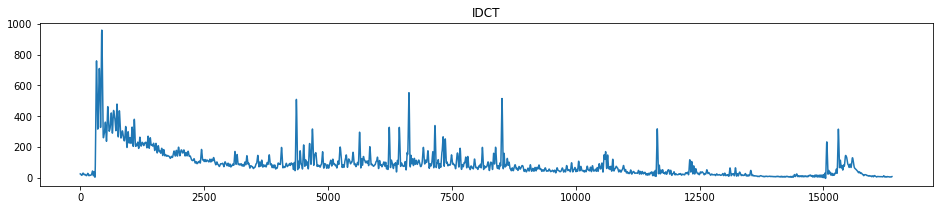

In [3]:
dr.dct(X[0], K = 1000, flavor='cv2')

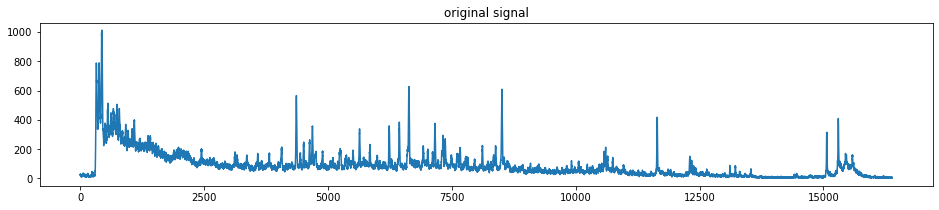

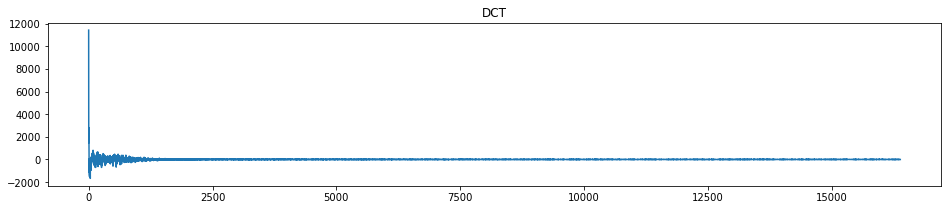

1000  /  16383  =  0.061038881767686015


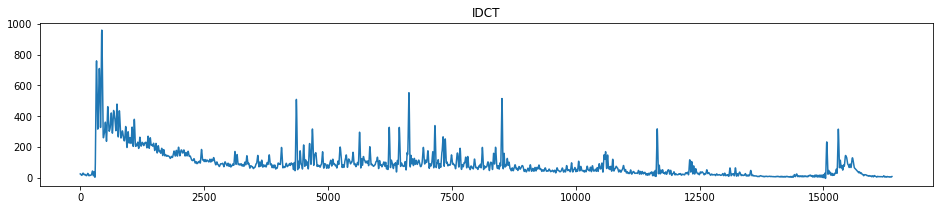

In [4]:
dr.dct(X[0], K = 1000, flavor='fftpack')

In [5]:
dr.dataset_dct_row_wise(X, K = 1000, flavor = 'fftpack')

100%|█████████████████████████████████████████████████████████████████████████████████| 90/90 [00:00<00:00, 717.56it/s]


(451.8578525481748, 38538.35467173412, 0.0117248869703197)

MAX / MIN 439.36654187627636 -83.92578897149811


THRESHOLD,Features per row,Non-zero percentage,MSE,Relative error
0.0,16382.0,1.0,2.249957008281613e-26,5.8378726302612055e-31
0.01,1.9111111111111112,0.00011665920590349843,982.3017194021544,0.025487386208930627
0.02,1.0777777777777777,6.57903661199962e-05,1538.3570111812633,0.039915128413962414
0.03,0.6666666666666666,4.069507182680177e-05,2087.937457129258,0.05417487040777465
0.04,0.43333333333333335,2.6451796687421154e-05,2671.2615476144247,0.06931014512582889
0.05,0.34444444444444444,2.102578711051425e-05,3090.63411681121,0.08019143589976267
0.06,0.24444444444444444,1.4921526336493983e-05,3760.950306809937,0.09758385950968414
0.07,0.16666666666666666,1.0173767956700443e-05,4491.909056840491,0.11654975114648651
0.08,0.1111111111111111,6.782511971133629e-06,5100.305473139237,0.13233556738202457
0.09,0.07777777777777778,4.747758379793541e-06,5296.887292996542,0.13743619651194908


0.011111111111111112 6.782511971133629e-07


C:\Users\eleve\anaconda3\lib\site-packages\scipy\stats\stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
C:\Users\eleve\anaconda3\lib\site-packages\scipy\stats\stats.py:4484: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


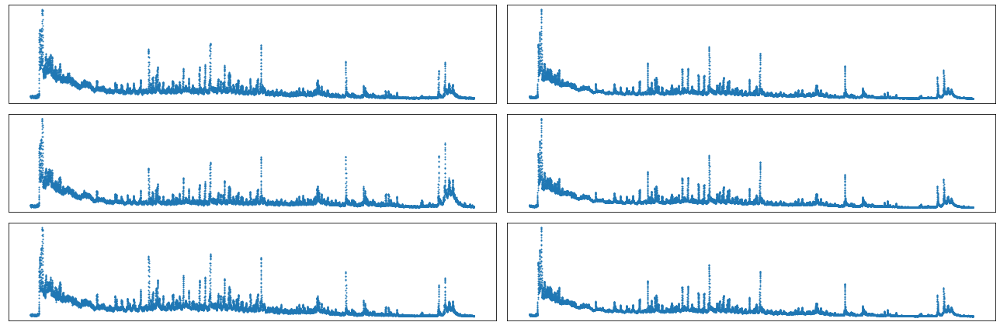

rMSE =  0.251779187555572
--- Distance Matrices (D and Dz) ---


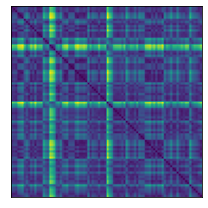

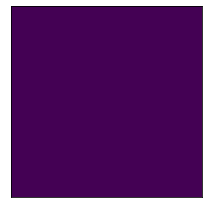

Residual Variance (using Pearson's r) =  nan
Residual Variance (using Spearman's r) =  nan
--- Ranking Matrices (R and Rz) ---


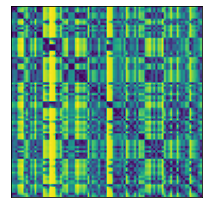

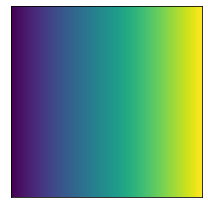

--- Co-ranking Matrix (Q) ---


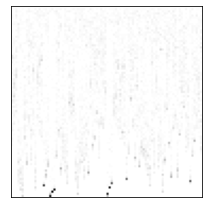

--- Trustworthiness T(k) and Continuity C(k) ---


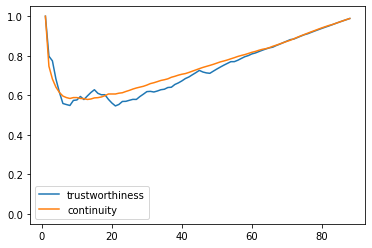

AUC of T =  0.7383308028990172
AUC of C =  0.7528638149443221
--- QNN(k) Curve ---


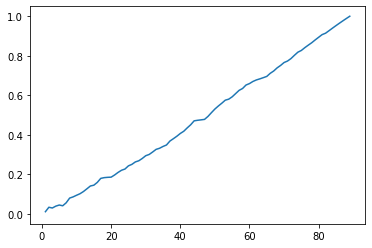

AUC of QNN =  0.48088003773632215
--- LCMC(k) Curve ---


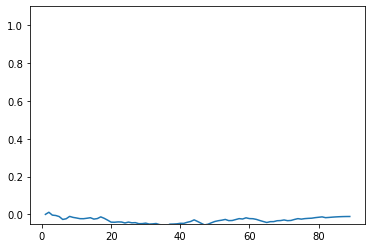

kmax (0-based index) =  1
Qlocal =  0.02247191011235955
Qglobal =  0.480311349465247


In [7]:
dr.dataset_dct(X, tq = 0.999, flavor = 'fftpack')

MAX / MIN 439.36654187627636 -83.92578897149829


THRESHOLD,Features per row,Non-zero percentage,MSE,Relative error
0.0,16382.0,1.0,1.67108896459552e-19,4.3359070832177765e-24
0.01,1.9111111111111112,0.00011665920590349843,982.3017194003666,0.02548738620888424
0.02,1.0777777777777777,6.57903661199962e-05,1538.3570111804813,0.039915128413942125
0.03,0.6666666666666666,4.069507182680177e-05,2087.9374571284784,0.05417487040775442
0.04,0.43333333333333335,2.6451796687421154e-05,2671.2615476135693,0.0693101451258067
0.05,0.34444444444444444,2.102578711051425e-05,3090.634116810311,0.08019143589973934
0.06,0.24444444444444444,1.4921526336493983e-05,3760.9503068090016,0.09758385950965986
0.07,0.16666666666666666,1.0173767956700443e-05,4491.909056839617,0.11654975114646382
0.08,0.1111111111111111,6.782511971133629e-06,5100.305473138372,0.1323355673820021
0.09,0.07777777777777778,4.747758379793541e-06,5296.887292995677,0.13743619651192662


0.011111111111111112 6.782511971133629e-07


C:\Users\eleve\anaconda3\lib\site-packages\scipy\stats\stats.py:4023: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
C:\Users\eleve\anaconda3\lib\site-packages\scipy\stats\stats.py:4484: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


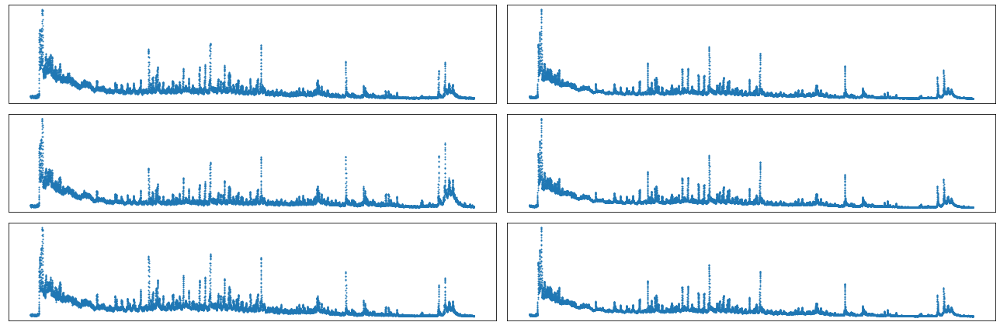

rMSE =  0.25177918755557194
--- Distance Matrices (D and Dz) ---


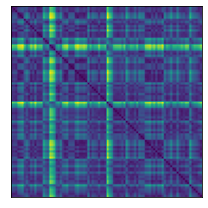

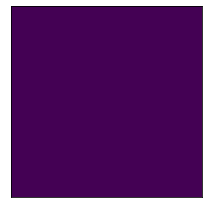

Residual Variance (using Pearson's r) =  nan
Residual Variance (using Spearman's r) =  nan
--- Ranking Matrices (R and Rz) ---


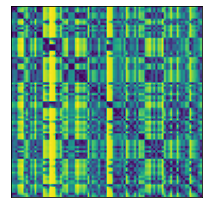

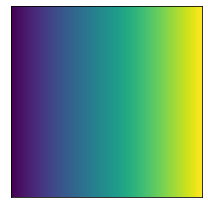

--- Co-ranking Matrix (Q) ---


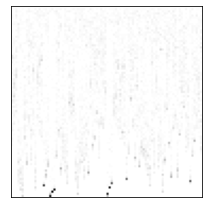

--- Trustworthiness T(k) and Continuity C(k) ---


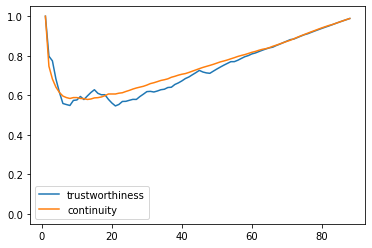

AUC of T =  0.7383308028990172
AUC of C =  0.7528638149443221
--- QNN(k) Curve ---


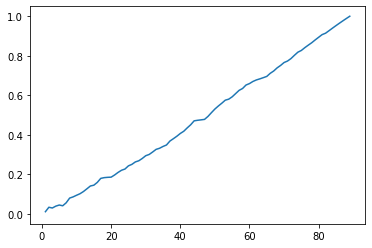

AUC of QNN =  0.48088003773632215
--- LCMC(k) Curve ---


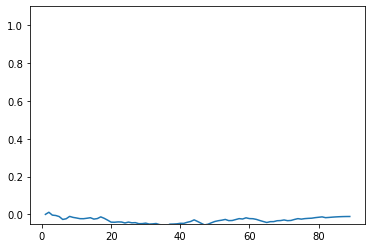

kmax (0-based index) =  1
Qlocal =  0.02247191011235955
Qglobal =  0.480311349465247


In [4]:
dr.dataset_dct(X, tq = 0.99, flavor = 'cv2')

<hr/>
<br/><br/><br/><br/><br/><br/><br/>
<hr/>


# Other Case Studies
## UV dataset of Herbs

In [2]:
import warnings
warnings.filterwarnings('ignore')

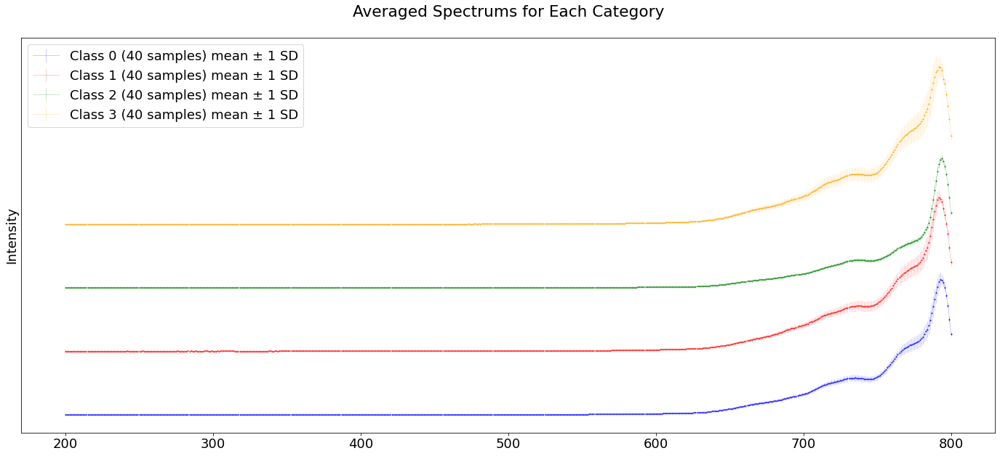

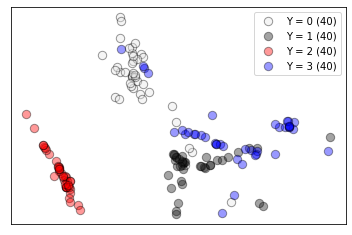

Ultraviolet-vis spectra of radix astragali (astragalus root, 黄芪, Huang-qi). 

UV spectra
  X meaning: wavelength
  X range: 200 ~ 800 nm
  Dimensions: 602
  Resolution: 1 nm

Radix astragali is a widely used medicinal herb in traditional Chinese medicine (TCM). The major chemical components of radix astragali include polysaccharides, saponins, alkaloids, flavonoids, and various mineral elements. It is often used to treat diabetes and cardiovascular diseases.

All Radix Astragali samples were obtained from Simcere Company Limited (China); the origins of these samples were：

label = 0: Inner Mongolia (North China), 
label = 1: Sichuan (Southwest China), 
label = 2: Shanxi (Northwest China), 
label = 3: Gansu (Northwest China).

Among these regions, Inner Mongolia, Shanxi, and Gansu are traditional daodi regions.
-----------------------------------
If you use this dataset, reference this article: 
[1] Spectroscopic Profiling-based Geographic Herb Identification by Neural Network with Rand

In [3]:
from qsi import io
X, y, X_names, _ = io.LoadDataSet('huangqi_uv', shift = 1, SD = 1)

Using TensorFlow backend.


Because some algorithms (e.g., NMF) require non-negative input, we shift up X by | X.min() |


=======  PCA  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


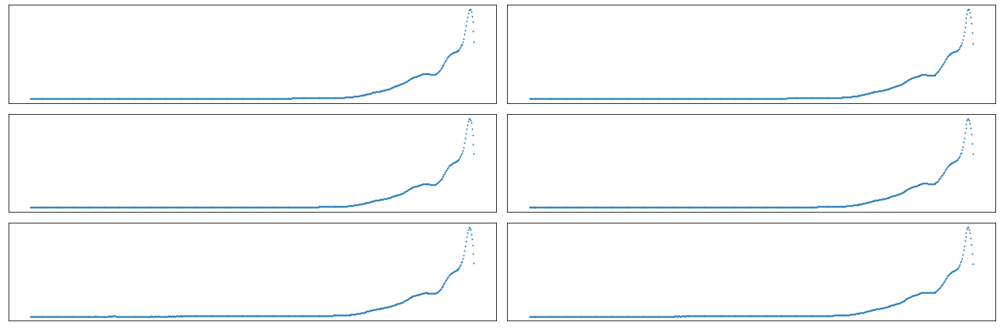

rMSE =  0.00014152772219045684
--- Distance Matrices (D and Dz) ---


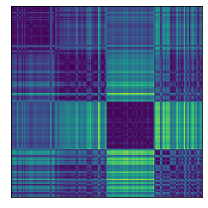

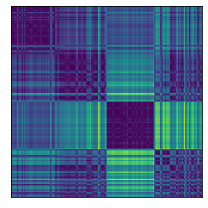

Residual Variance (using Pearson's r) =  9.578922880593144e-05
Residual Variance (using Spearman's r) =  0.00022330177084350922
--- Ranking Matrices (R and Rz) ---


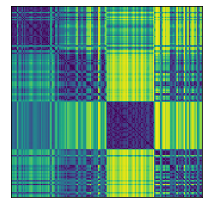

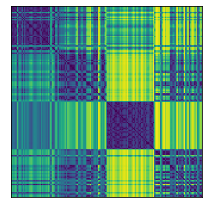

--- Co-ranking Matrix (Q) ---


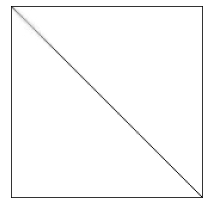

--- Trustworthiness T(k) and Continuity C(k) ---


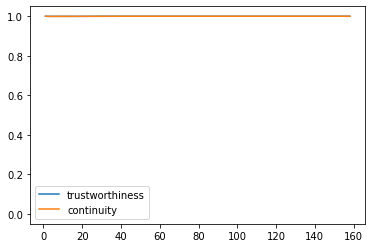

AUC of T =  0.99991428809189
AUC of C =  0.9999288429475602
--- QNN(k) Curve ---


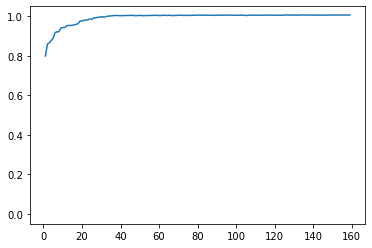

AUC of QNN =  0.993911756384253
--- LCMC(k) Curve ---


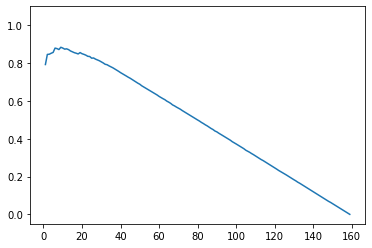

kmax (0-based index) =  8
Qlocal =  0.8877072865018358
Qglobal =  0.9998461023782697


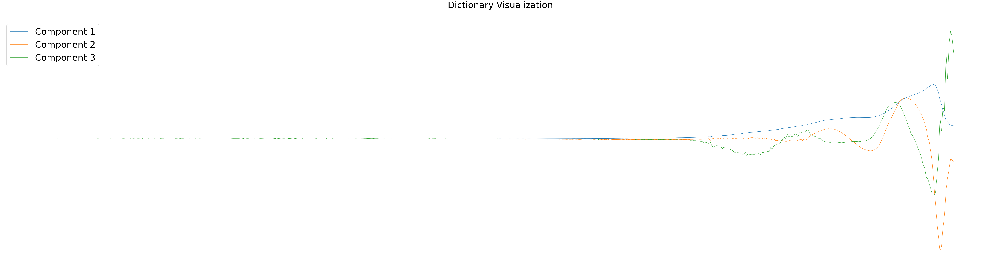

X[0]


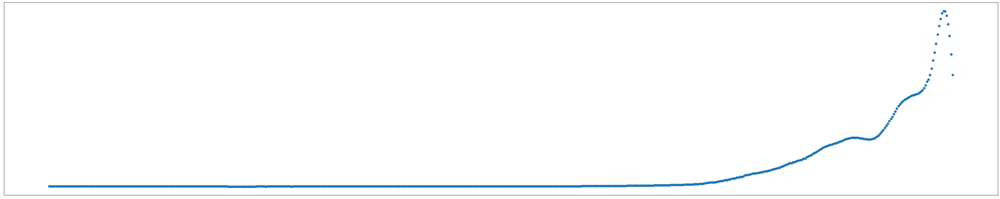

Xr[0]


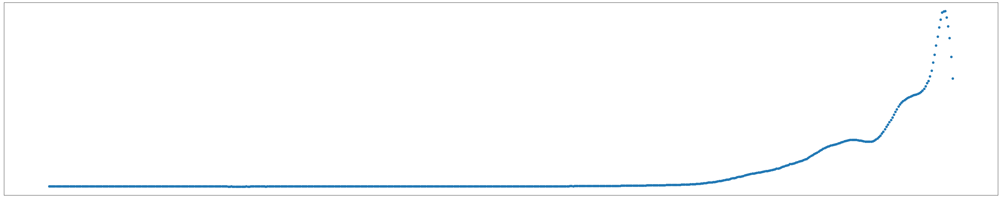



=======  NMF  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


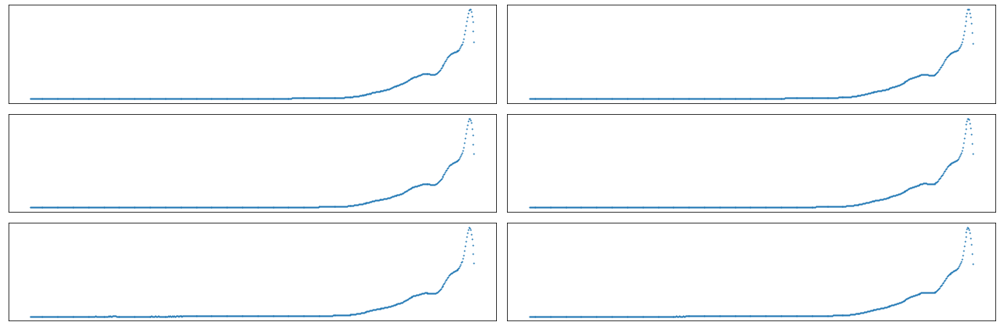

rMSE =  0.00016699453157533863
--- Distance Matrices (D and Dz) ---


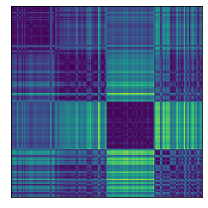

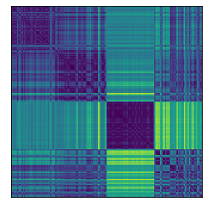

Residual Variance (using Pearson's r) =  0.13057960798064472
Residual Variance (using Spearman's r) =  0.14985565626095187
--- Ranking Matrices (R and Rz) ---


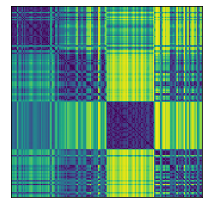

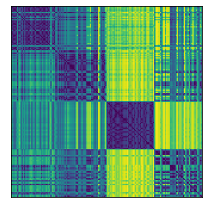

--- Co-ranking Matrix (Q) ---


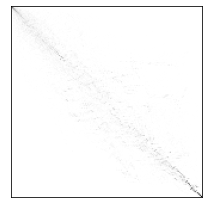

--- Trustworthiness T(k) and Continuity C(k) ---


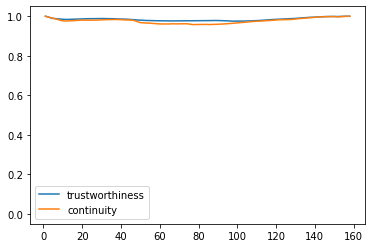

AUC of T =  0.9844916092041605
AUC of C =  0.97682682076557
--- QNN(k) Curve ---


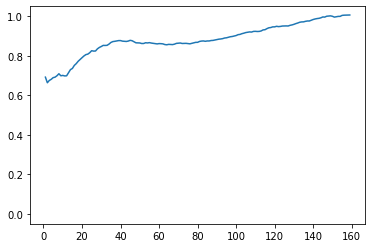

AUC of QNN =  0.8818346200005309
--- LCMC(k) Curve ---


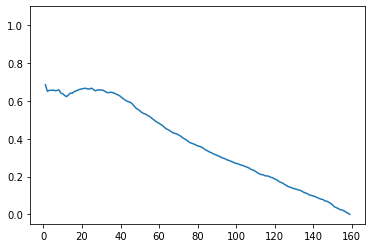

kmax (0-based index) =  0
Qlocal =  0.6918238993710691
Qglobal =  0.8810469321006856


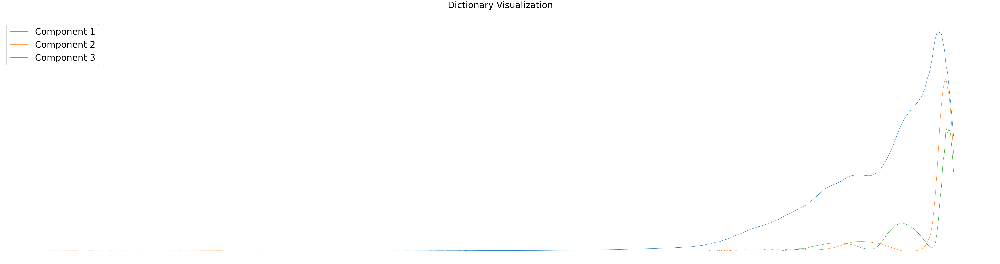

X[0]


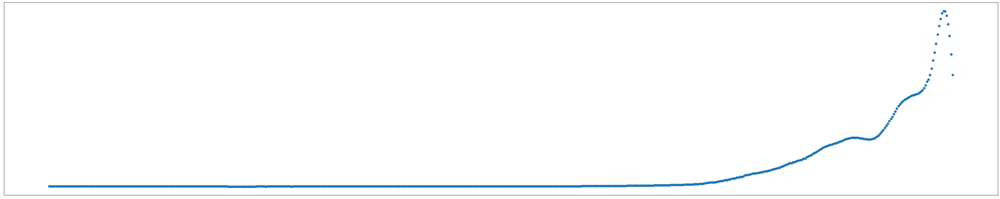

Xr[0]


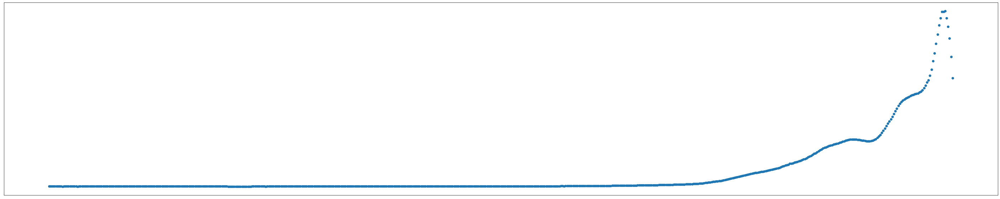



=======  LAE  =======


--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


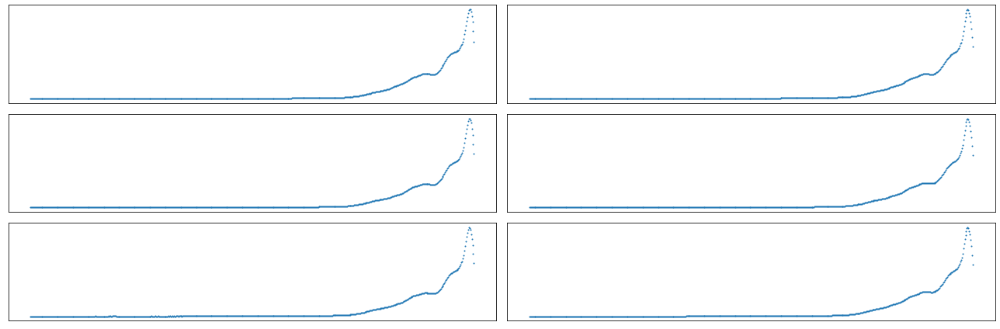

rMSE =  0.042042779974178546
--- Distance Matrices (D and Dz) ---


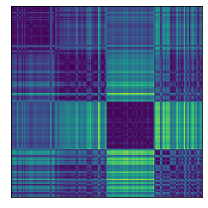

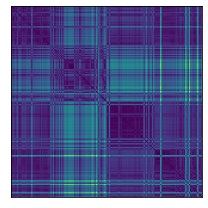

Residual Variance (using Pearson's r) =  0.9825936582605637
Residual Variance (using Spearman's r) =  0.9425021522419458
--- Ranking Matrices (R and Rz) ---


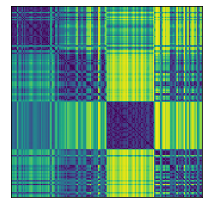

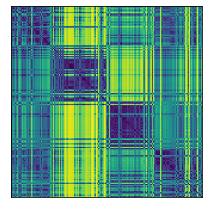

--- Co-ranking Matrix (Q) ---


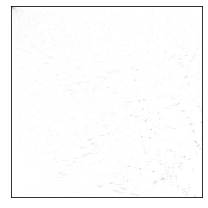

--- Trustworthiness T(k) and Continuity C(k) ---


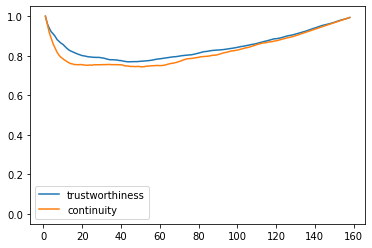

AUC of T =  0.8486786901251627
AUC of C =  0.8262283851457037
--- QNN(k) Curve ---


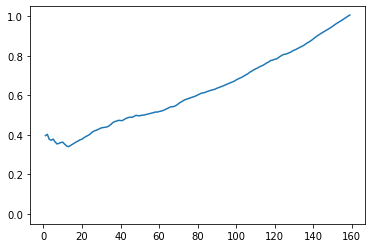

AUC of QNN =  0.6245621743467422
--- LCMC(k) Curve ---


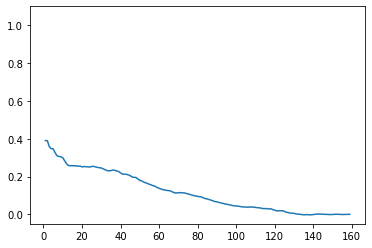

kmax (0-based index) =  0
Qlocal =  0.39622641509433965
Qglobal =  0.6221461798288348


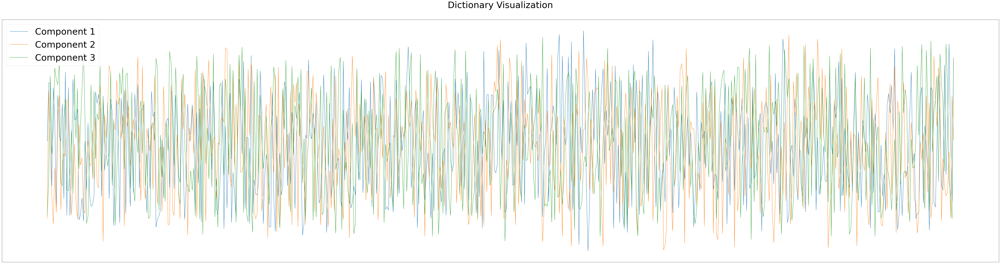

X[0]


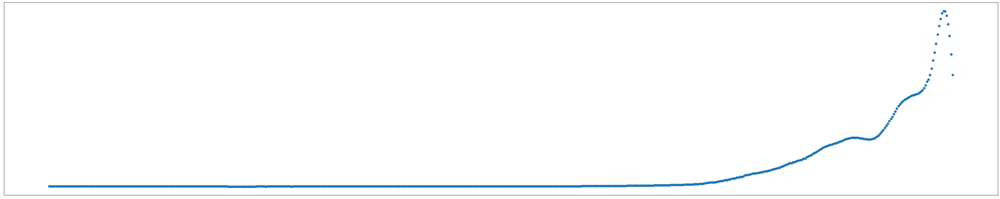

Xr[0]


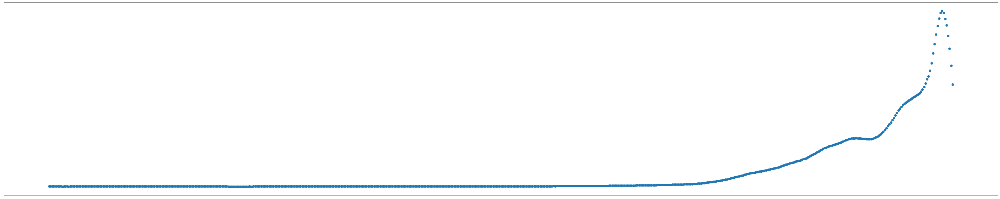



=======  RP  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


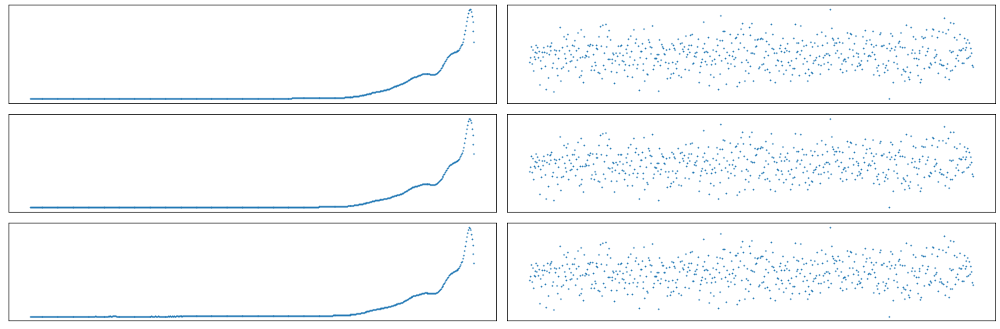

rMSE =  207.1403544375724
--- Distance Matrices (D and Dz) ---


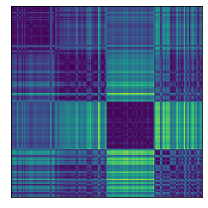

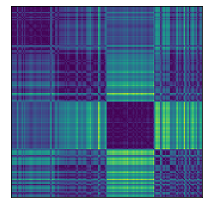

Residual Variance (using Pearson's r) =  0.0022351475477879745
Residual Variance (using Spearman's r) =  0.0033414115555924218
--- Ranking Matrices (R and Rz) ---


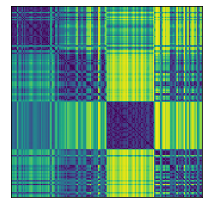

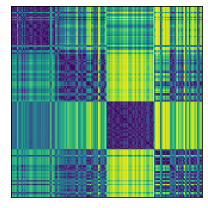

--- Co-ranking Matrix (Q) ---


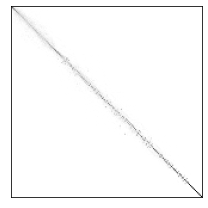

--- Trustworthiness T(k) and Continuity C(k) ---


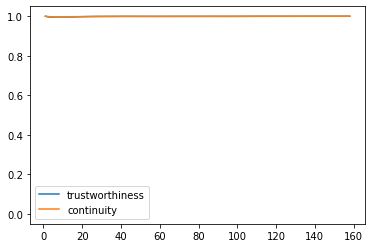

AUC of T =  0.9991517976210702
AUC of C =  0.9992769898523817
--- QNN(k) Curve ---


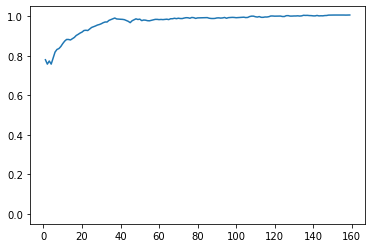

AUC of QNN =  0.9718174297469984
--- LCMC(k) Curve ---


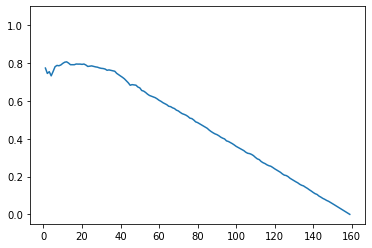

kmax (0-based index) =  11
Qlocal =  0.8174278726165518
Qglobal =  0.9835792321830666


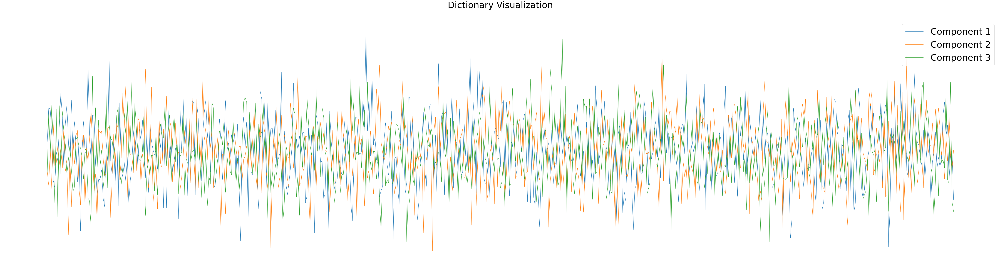

X[0]


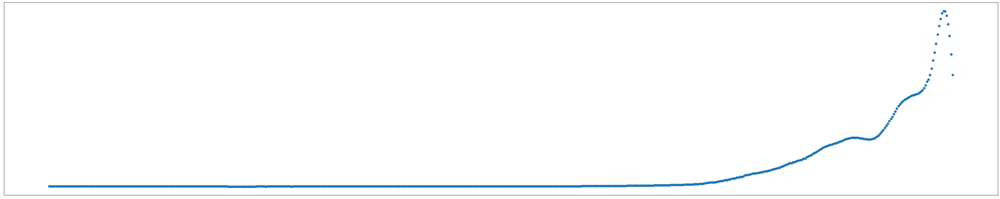

Xr[0]


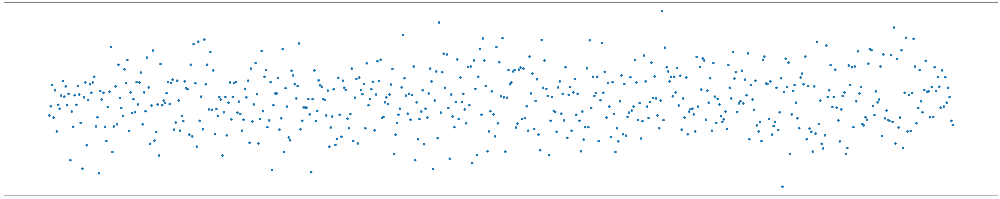



=======  SRP  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


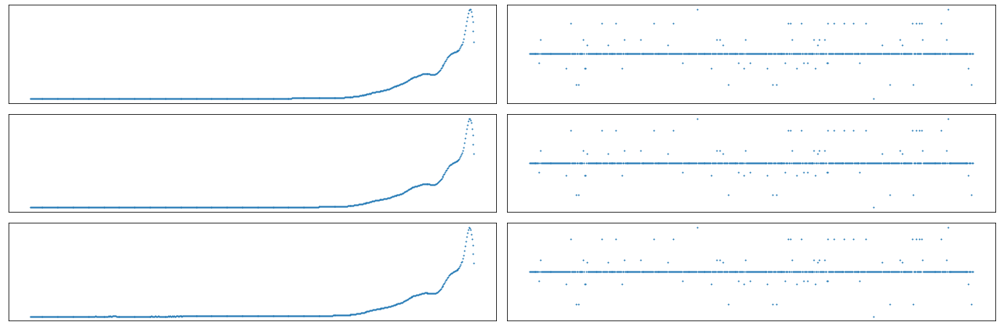

rMSE =  72.39237041516263
--- Distance Matrices (D and Dz) ---


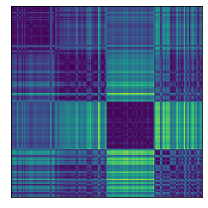

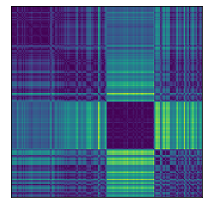

Residual Variance (using Pearson's r) =  0.029485532872586817
Residual Variance (using Spearman's r) =  0.03721698251350802
--- Ranking Matrices (R and Rz) ---


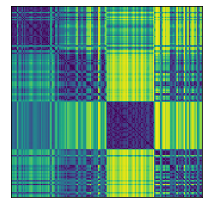

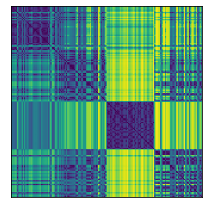

--- Co-ranking Matrix (Q) ---


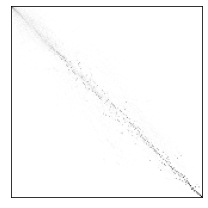

--- Trustworthiness T(k) and Continuity C(k) ---


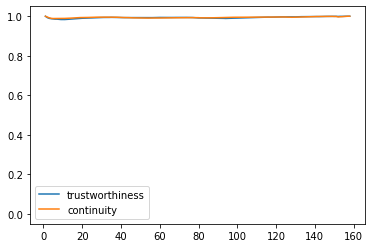

AUC of T =  0.9933707442079462
AUC of C =  0.994218860512407
--- QNN(k) Curve ---


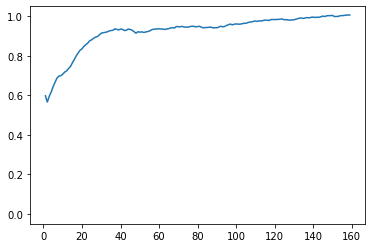

AUC of QNN =  0.9240468799965775
--- LCMC(k) Curve ---


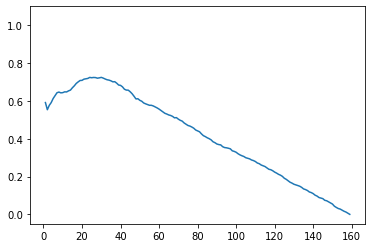

kmax (0-based index) =  29
Qlocal =  0.7681932744251707
Qglobal =  0.9595784662304168


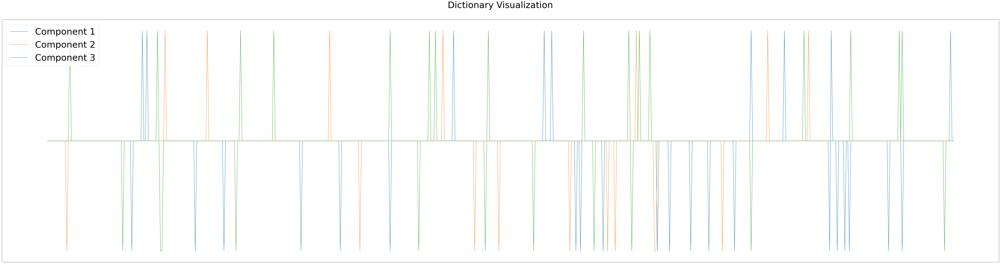

X[0]


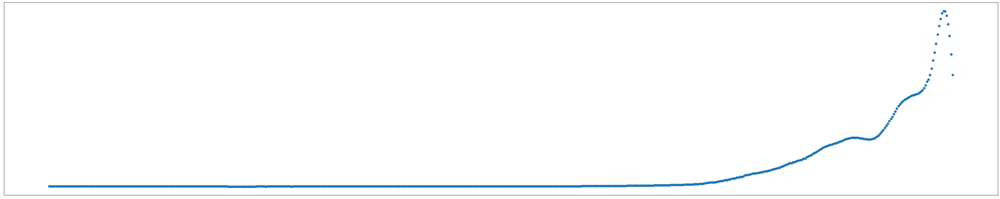

Xr[0]


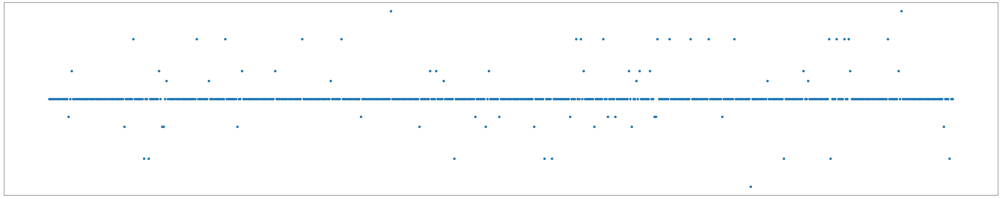



=======  VQ  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


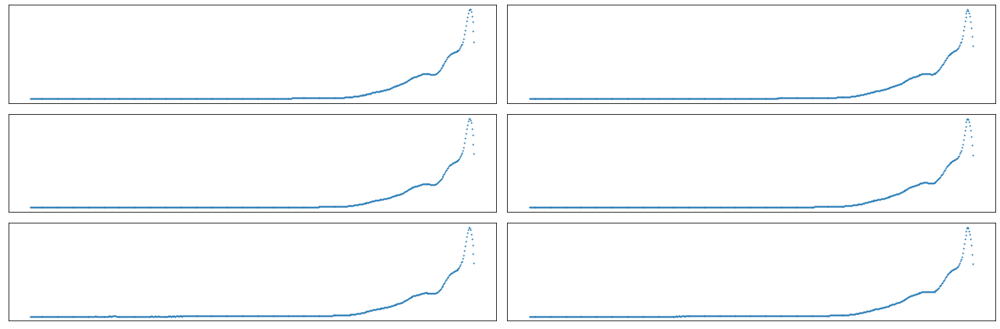

rMSE =  0.005703777956158651
--- Distance Matrices (D and Dz) ---


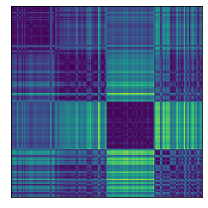

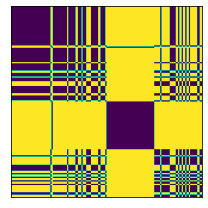

Residual Variance (using Pearson's r) =  0.5350091787287253
Residual Variance (using Spearman's r) =  0.4410695667503449
--- Ranking Matrices (R and Rz) ---


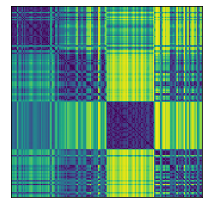

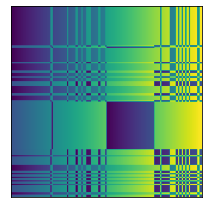

--- Co-ranking Matrix (Q) ---


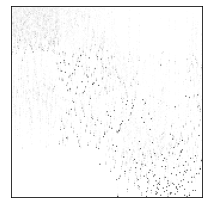

--- Trustworthiness T(k) and Continuity C(k) ---


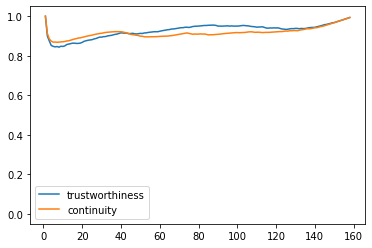

AUC of T =  0.927160707787236
AUC of C =  0.9162522709960036
--- QNN(k) Curve ---


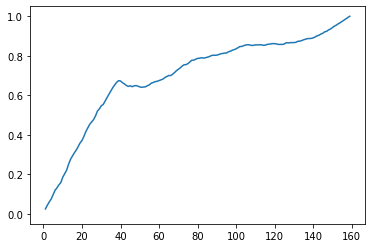

AUC of QNN =  0.7001100466441578
--- LCMC(k) Curve ---


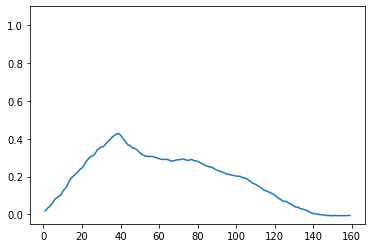

kmax (0-based index) =  38
Qlocal =  0.36668905616730124
Qglobal =  0.8057565933703508


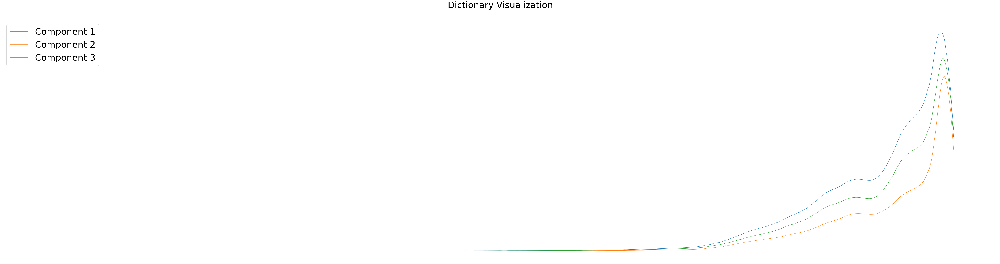

X[0]


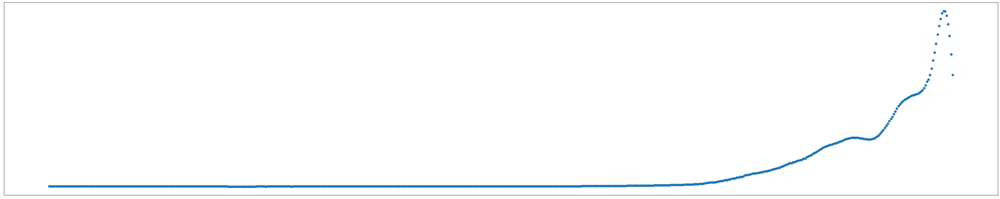

Xr[0]


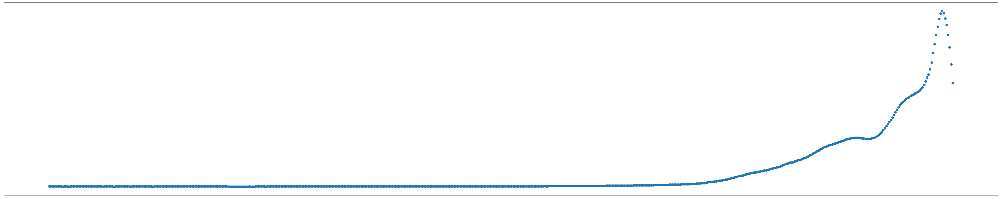



=======  AA  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


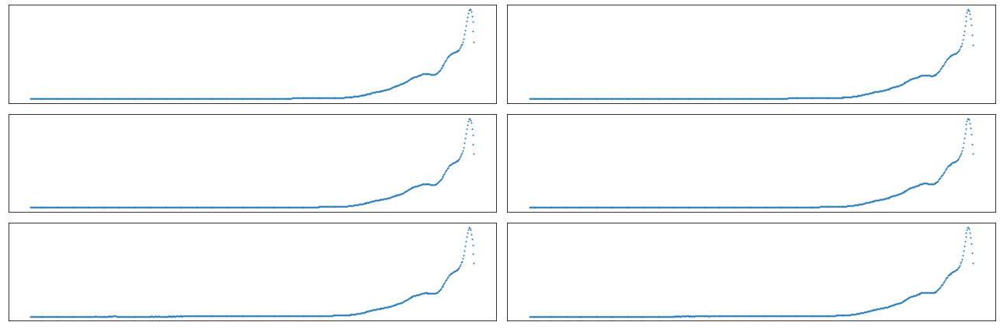

rMSE =  0.0005323353993125366
--- Distance Matrices (D and Dz) ---


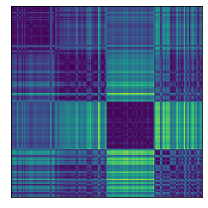

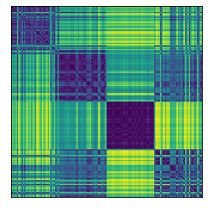

Residual Variance (using Pearson's r) =  0.44971805468955484
Residual Variance (using Spearman's r) =  0.44552549304351485
--- Ranking Matrices (R and Rz) ---


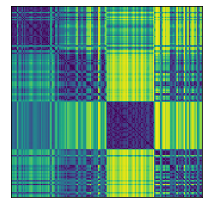

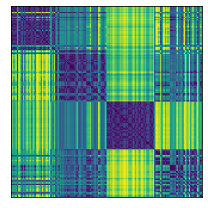

--- Co-ranking Matrix (Q) ---


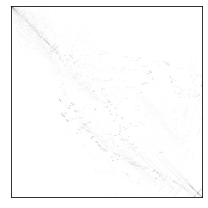

--- Trustworthiness T(k) and Continuity C(k) ---


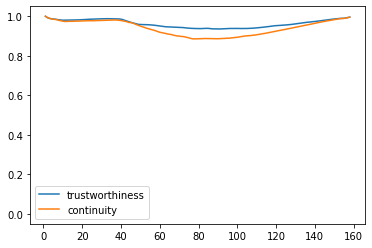

AUC of T =  0.9625635003345376
AUC of C =  0.9407668491098853
--- QNN(k) Curve ---


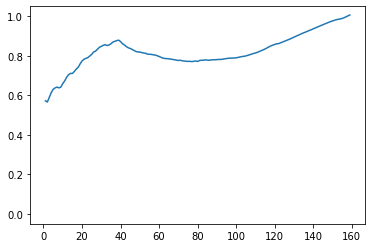

AUC of QNN =  0.8216876828475314
--- LCMC(k) Curve ---


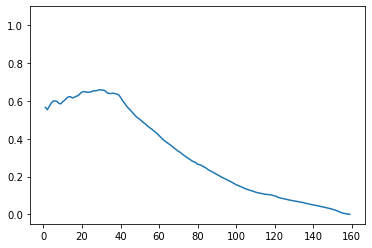

kmax (0-based index) =  28
Qlocal =  0.7133463567302172
Qglobal =  0.8445949343816237


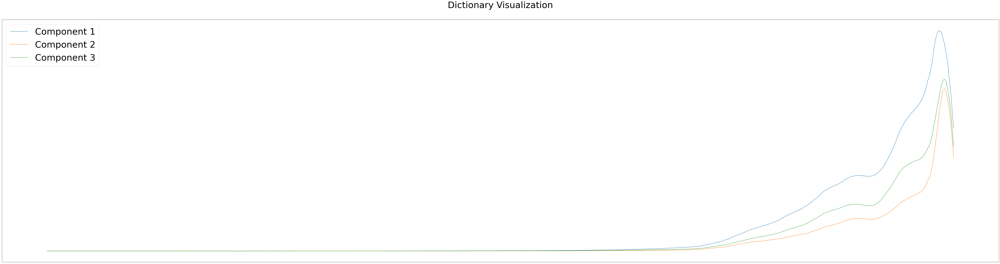

X[0]


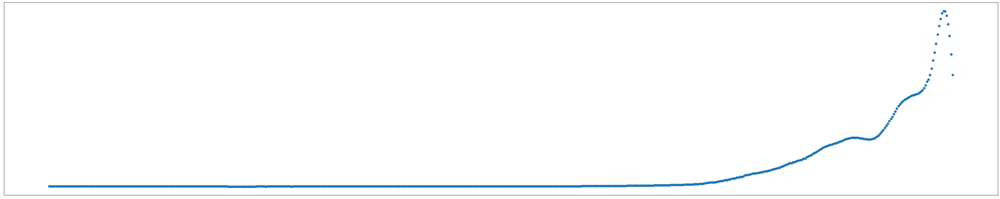

Xr[0]


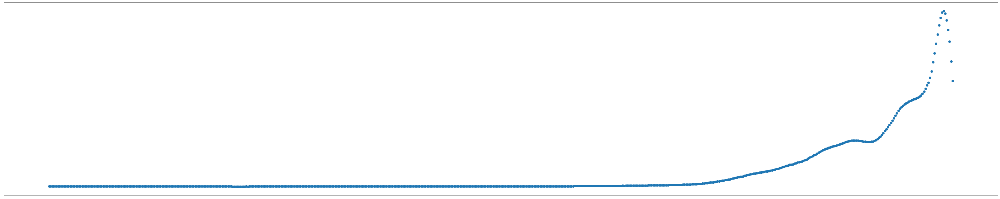



=======  ICA  =======

--- Sample Reconstruction (X and Xr) ---
left column: original waveform		 right column: recovered waveform


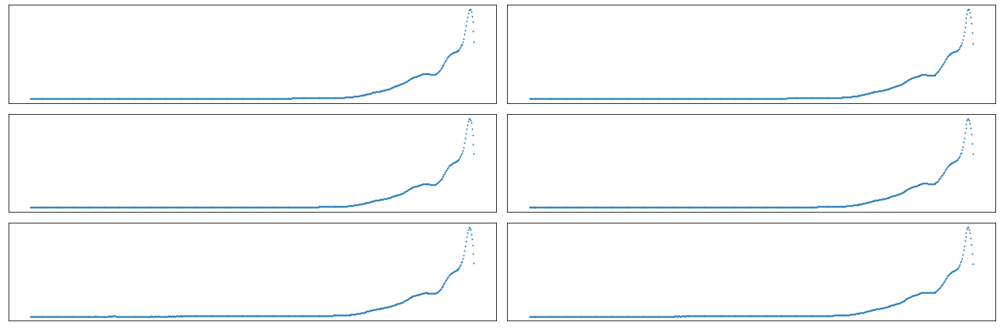

rMSE =  0.00014152772219045684
--- Distance Matrices (D and Dz) ---


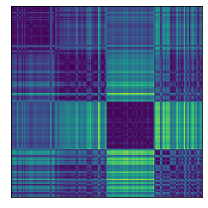

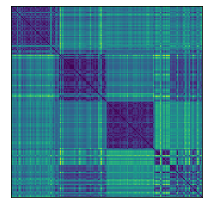

Residual Variance (using Pearson's r) =  0.6075089960553494
Residual Variance (using Spearman's r) =  0.591955868200222
--- Ranking Matrices (R and Rz) ---


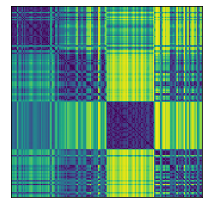

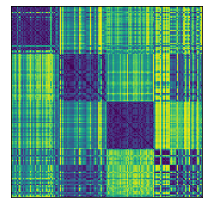

--- Co-ranking Matrix (Q) ---


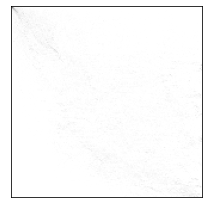

--- Trustworthiness T(k) and Continuity C(k) ---


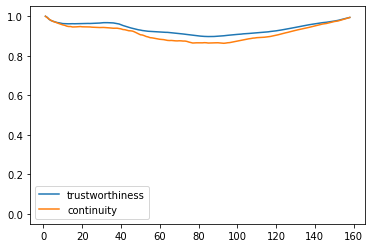

AUC of T =  0.9390094389135479
AUC of C =  0.9171896898701077
--- QNN(k) Curve ---


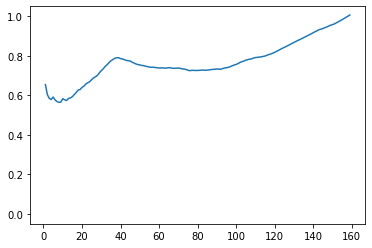

AUC of QNN =  0.7697660621213527
--- LCMC(k) Curve ---


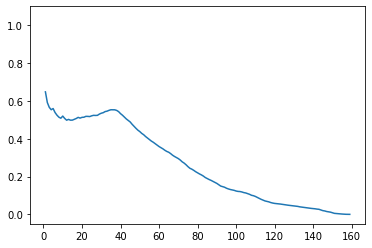

kmax (0-based index) =  0
Qlocal =  0.6540880503144654
Qglobal =  0.7682690795513859


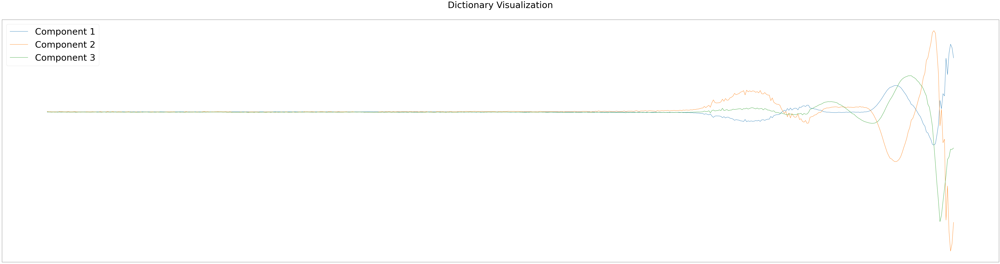

X[0]


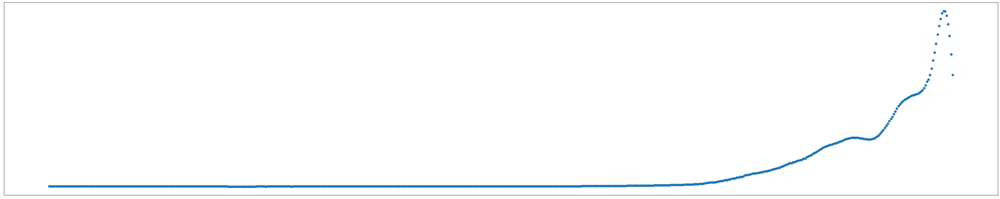

Xr[0]


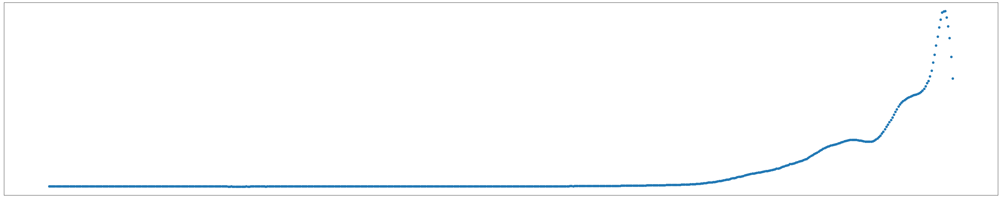

In [4]:
from qsi.dr import mf
mf.compare_all(X, k = 3)

Because some algorithms (e.g., NMF) require non-negative input, we shift up X by | X.min() |


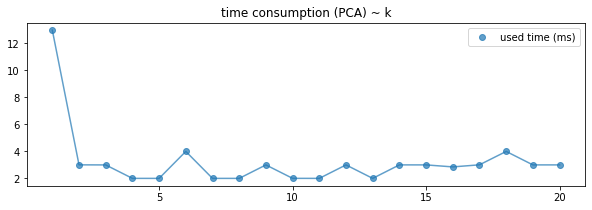

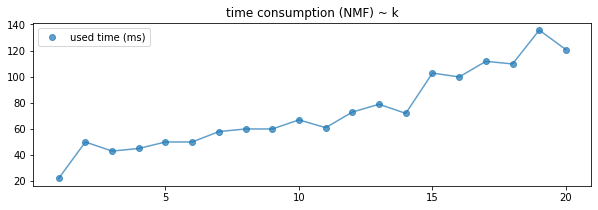

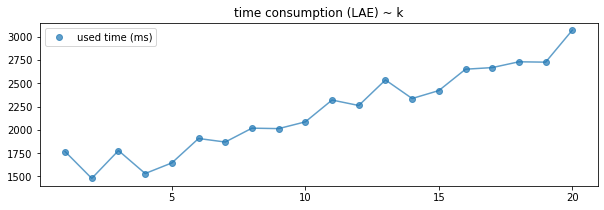

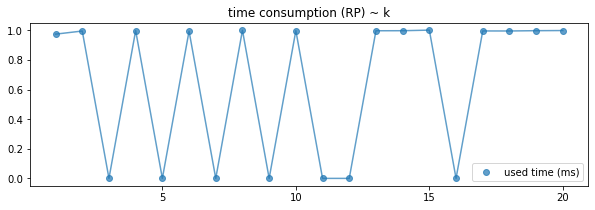

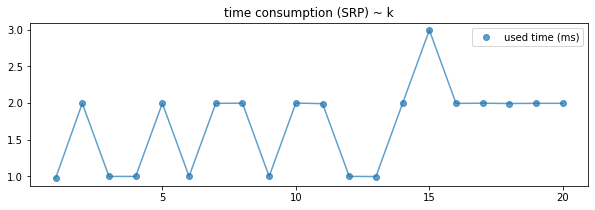

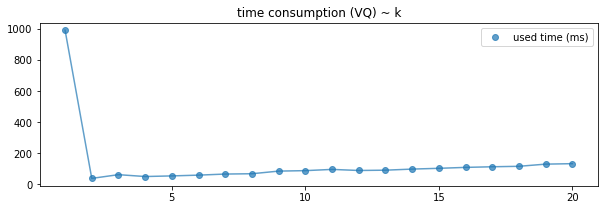

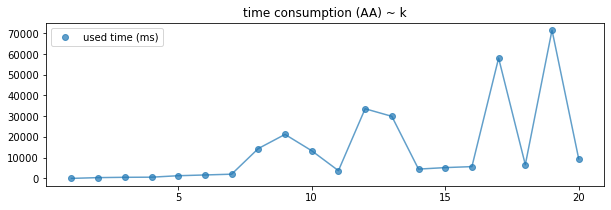

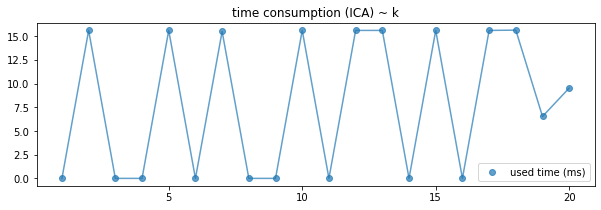

In [5]:
# measure run time of all algorithms
TSS = mf.measure_time_all(X, repeat = 1)